# **Testing Models**

**Author:** Arnav Singh 
**Date:** 2024-11-12

---

## **Abstract**

For this notebook, we will use the OMNI and OCB data from the dayside and Nightside files to explore which edited data works the best with the neural network and random forest. 

In [1]:
### Imports ####
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks, regularizers
import keras_tuner as kt

In [2]:
nightside_df = pd.read_parquet('data/5minData.parquet')
nightside_df = nightside_df[['b6_date', 'b6_mag_lat', 'b6_mlt' , 'b2i_mag_lat' , 'MAG_AVG_B-VECTOR_nT' , 'BZ__GSM_nT', 'FLOW_PRESSURE_nPa' , 'FLOW_SPEED__GSE_km/s' , '5-M_AE_nT', 'SYM/H_INDEX_nT' , '5-M_PC(N)-INDEX_' , 'PROTON_DENSITY_n/cc', 'dFMP_dt']]
nightside_df.describe()

,b6_date,b6_mag_lat,b6_mlt,b2i_mag_lat,MAG_AVG_B-VECTOR_nT,BZ__GSM_nT,FLOW_PRESSURE_nPa,FLOW_SPEED__GSE_km/s,5-M_AE_nT,SYM/H_INDEX_nT,5-M_PC(N)-INDEX_,PROTON_DENSITY_n/cc,dFMP_dt
count,483943,483943.000000,483943.000000,483943.000000,483943.000000,483943.000000,483943.000000,483943.000000,483943.000000,483943.000000,483943.000000,483943.000000,242034.000000
mean,2002-11-03 23:55:51.074328960,-19.001739,13.762640,-17.307974,6.248162,-0.207518,2.361047,441.493922,215.201666,-13.517668,1.143528,6.743317,4203.285129
min,1983-12-05 00:36:18,-89.970000,0.000000,-89.140000,0.260000,-54.990000,0.020000,231.800000,2.000000,-475.000000,-16.220000,0.090000,0.000000
25%,1998-07-13 13:41:58.500000,-75.480000,6.050000,-68.280000,4.180000,-2.140000,1.340000,360.500000,54.000000,-21.000000,0.200000,3.350000,1002.907335
50%,2003-05-24 10:48:33,-70.870000,17.130000,-64.790000,5.540000,-0.190000,1.920000,416.800000,129.000000,-10.000000,0.810000,5.200000,3017.425966
75%,2007-08-28 00:15:52.500000,74.060000,20.040000,66.450000,7.420000,1.770000,2.790000,502.000000,302.000000,-2.000000,1.810000,8.300000,5934.565018
max,2012-12-31 22:18:34,90.000000,24.000000,88.880000,56.470000,39.530000,89.510000,1130.800000,3274.000000,97.000000,29.080000,71.440000,120906.366746
std,NaN,73.113363,7.569462,65.235929,3.295993,3.645215,1.838813,107.206271,227.164017,20.911351,1.457352,5.383610,4580.793781


In [3]:
dayside_df = pd.read_parquet('data/Dayside.parquet')
dayside_df.describe()

,OCB_Date,OCB_mlat,OCB_mlt,EPOCH_TIME_yyyy-mm-ddThh:mm:ss.sssZ,TIMESHIFT_seconds,MAG_AVG_B-VECTOR_nT,BX__GSE_nT,BY__GSM_nT,BZ__GSM_nT,FLOW_SPEED__GSE_km/s,...,PROTON_DENSITY_n/cc,FLOW_PRESSURE_nPa,5-M_AE_nT,5-M_AL-INDEX_nT,SYM/H_INDEX_nT,5-M_PC(N)-INDEX_,BT,qc,sin_term,dFMP_dt
count,437644,437644.000000,437644.000000,437644,437644.000000,437644.000000,437644.000000,437644.000000,437644.000000,437644.000000,...,437644.000000,437644.000000,437644.000000,437644.000000,437644.000000,437644.000000,437644.000000,437644.000000,213160.000000,213160.000000
mean,2003-06-01 14:36:20.500443008,6.040775,11.697393,2003-06-01 14:36:19.860800,2362.558701,5.907477,0.075834,-0.070200,-0.354826,436.225657,...,6.473615,2.223449,212.995867,-137.709360,-13.172677,1.177026,4.429847,-0.058896,0.461304,4097.295290
min,1983-12-05 00:47:40,-89.760000,0.110000,1983-12-05 00:50:00,-10189.000000,0.260000,-40.990000,-42.590000,-54.400000,234.400000,...,0.030000,0.010000,1.000000,-3032.000000,-475.000000,-11.790000,0.010000,-3.141593,0.000000,0.000000
25%,1999-02-11 06:19:51.750000,-77.820000,7.850000,1999-02-11 06:21:15,681.000000,3.920000,-2.600000,-2.710000,-2.150000,356.100000,...,3.190000,1.240000,51.000000,-195.000000,-20.000000,0.240000,2.455952,-1.720544,0.147689,1002.849111
50%,2004-04-11 13:21:29,72.470000,10.510000,2004-04-11 13:20:00,2618.000000,5.250000,0.110000,-0.150000,-0.290000,412.000000,...,4.970000,1.790000,127.000000,-72.000000,-10.000000,0.860000,3.813325,-0.146484,0.437412,2980.533893
75%,2008-01-29 00:29:56.500000,78.180000,16.470000,2008-01-29 00:30:00,3549.000000,7.060000,2.730000,2.560000,1.520000,496.400000,...,7.920000,2.650000,303.000000,-24.000000,-2.000000,1.840000,5.611355,1.615992,0.763063,5848.386906
max,2012-12-31 23:22:24,89.900000,23.970000,2012-12-31 23:20:00,10655.000000,59.690000,35.230000,47.740000,41.270000,1094.500000,...,70.800000,89.510000,2945.000000,38.000000,109.000000,24.110000,57.881329,3.141593,1.000000,111132.480707
std,NaN,77.666829,4.706631,NaN,1737.990144,3.111417,3.681877,4.132693,3.377761,105.762569,...,5.245134,1.739334,225.276487,166.579801,19.631408,1.417505,2.999276,1.830629,0.331910,4317.031442


In [4]:
nightsideN_df = nightside_df[(nightside_df['b6_mag_lat'] > 50) & (nightside_df['b6_mag_lat'] < 85)]
nightsideN_df.describe()

,b6_date,b6_mag_lat,b6_mlt,b2i_mag_lat,MAG_AVG_B-VECTOR_nT,BZ__GSM_nT,FLOW_PRESSURE_nPa,FLOW_SPEED__GSE_km/s,5-M_AE_nT,SYM/H_INDEX_nT,5-M_PC(N)-INDEX_,PROTON_DENSITY_n/cc,dFMP_dt
count,168720,168720.000000,168720.000000,168720.000000,168720.000000,168720.000000,168720.000000,168720.000000,168720.000000,168720.000000,168720.000000,168720.000000,83216.000000
mean,2001-10-14 10:03:36.336119040,76.142683,15.233504,68.006480,6.388529,-0.399888,2.454799,447.279442,237.781911,-14.620887,1.285841,6.847319,4457.822506
min,1983-12-05 00:36:18,50.220000,0.000000,22.420000,0.300000,-54.990000,0.050000,246.600000,2.000000,-470.000000,-16.220000,0.100000,0.000000
25%,1997-07-10 01:07:48.250000,72.950000,9.630000,65.720000,4.310000,-2.330000,1.410000,364.500000,61.000000,-22.000000,0.290000,3.410000,1127.186106
50%,2002-09-10 01:38:53.500000,76.050000,17.350000,68.000000,5.680000,-0.350000,2.000000,422.100000,151.000000,-11.000000,0.960000,5.270000,3246.689337
75%,2006-12-20 19:52:23.249999872,79.420000,19.220000,70.350000,7.570000,1.650000,2.900000,510.300000,339.000000,-2.000000,2.000000,8.440000,6292.942584
max,2012-12-31 16:30:13,84.990000,24.000000,88.880000,56.060000,37.630000,89.510000,1091.300000,3011.000000,97.000000,21.640000,71.440000,109286.901308
std,NaN,4.218707,5.744538,3.499748,3.316845,3.683287,1.918962,109.069541,239.954850,21.642193,1.509627,5.417004,4744.192839


In [5]:
nightsideS_df = nightside_df[(nightside_df['b6_mag_lat'] < -50) & (nightside_df['b6_mag_lat'] > -85)]
nightsideS_df.describe()

,b6_date,b6_mag_lat,b6_mlt,b2i_mag_lat,MAG_AVG_B-VECTOR_nT,BZ__GSM_nT,FLOW_PRESSURE_nPa,FLOW_SPEED__GSE_km/s,5-M_AE_nT,SYM/H_INDEX_nT,5-M_PC(N)-INDEX_,PROTON_DENSITY_n/cc,dFMP_dt
count,299357,299357.000000,299357.000000,299357.000000,299357.000000,299357.000000,299357.000000,299357.00000,299357.000000,299357.000000,299357.000000,299357.000000,150716.000000
mean,2003-05-03 14:41:06.741632768,-74.519601,13.036397,-67.034516,6.158361,-0.202702,2.295949,438.71811,208.220967,-13.299913,1.096792,6.635695,4144.253038
min,1983-12-05 00:48:09,-84.990000,0.000000,-89.140000,0.260000,-54.400000,0.020000,231.80000,2.000000,-475.000000,-13.410000,0.090000,0.000000
25%,1998-12-29 14:41:39,-77.640000,4.090000,-69.550000,4.130000,-2.100000,1.310000,358.80000,53.000000,-21.000000,0.170000,3.310000,1005.700199
50%,2003-08-14 11:53:06,-73.980000,17.110000,-67.440000,5.460000,-0.170000,1.860000,414.50000,124.000000,-10.000000,0.760000,5.120000,2992.683487
75%,2007-11-02 02:09:54,-71.290000,20.630000,-65.320000,7.320000,1.750000,2.720000,497.70000,291.000000,-2.000000,1.730000,8.150000,5849.907941
max,2012-12-31 22:18:34,-50.160000,24.000000,-20.020000,56.470000,36.560000,73.140000,1130.80000,3059.000000,95.000000,21.900000,70.800000,95465.606665
std,NaN,4.314957,8.394499,5.242411,3.236922,3.562904,1.763516,106.00662,220.774769,20.562989,1.420975,5.299043,4499.875385


In [6]:
daysideN_df = dayside_df[(dayside_df['OCB_mlat'] > 50) & (dayside_df['OCB_mlat'] < 85)]
daysideN_df.describe()

,OCB_Date,OCB_mlat,OCB_mlt,EPOCH_TIME_yyyy-mm-ddThh:mm:ss.sssZ,TIMESHIFT_seconds,MAG_AVG_B-VECTOR_nT,BX__GSE_nT,BY__GSM_nT,BZ__GSM_nT,FLOW_SPEED__GSE_km/s,...,PROTON_DENSITY_n/cc,FLOW_PRESSURE_nPa,5-M_AE_nT,5-M_AL-INDEX_nT,SYM/H_INDEX_nT,5-M_PC(N)-INDEX_,BT,qc,sin_term,dFMP_dt
count,229180,229180.000000,229180.000000,229180,229180.000000,229180.000000,229180.000000,229180.000000,229180.000000,229180.000000,...,229180.000000,229180.000000,229180.000000,229180.000000,229180.000000,229180.000000,229180.000000,229180.000000,105969.000000,105969.000000
mean,2003-08-10 20:59:24.197739776,77.508448,12.315415,2003-08-10 20:59:23.538703104,2376.751881,5.960242,0.202947,-0.289296,-0.570114,437.956018,...,6.501547,2.250126,226.418217,-146.001030,-14.281351,1.306133,4.478826,-0.137941,0.485856,4339.118939
min,1983-12-05 01:36:04,50.990000,0.610000,1983-12-05 01:35:00,-10189.000000,0.270000,-40.510000,-42.590000,-54.400000,234.400000,...,0.090000,0.030000,2.000000,-2420.000000,-462.000000,-8.490000,0.010000,-3.141593,0.000000,0.000000
25%,1999-04-30 08:02:18,75.290000,8.930000,1999-04-30 08:03:45,770.000000,3.960000,-2.490000,-2.910000,-2.370000,357.000000,...,3.200000,1.250000,54.000000,-212.000000,-22.000000,0.310000,2.485141,-1.822249,0.168602,1121.918793
50%,2004-06-09 09:20:05,77.710000,11.610000,2004-06-09 09:20:00,2624.000000,5.290000,0.290000,-0.410000,-0.490000,413.600000,...,4.990000,1.810000,144.000000,-82.000000,-11.000000,0.970000,3.854458,-0.428466,0.478764,3253.975000
75%,2008-02-10 16:37:53.750000128,79.860000,16.350000,2008-02-10 16:36:15,3542.000000,7.110000,2.850000,2.350000,1.340000,499.600000,...,7.960000,2.690000,330.000000,-25.000000,-2.000000,1.990000,5.665803,1.629181,0.797081,6218.852059
max,2012-12-31 23:22:24,84.990000,22.780000,2012-12-31 23:20:00,10640.000000,59.690000,30.940000,47.740000,38.870000,1068.000000,...,69.690000,89.510000,2945.000000,38.000000,109.000000,24.110000,57.881329,3.141593,1.000000,111132.480707
std,NaN,3.355374,4.127090,NaN,1720.941323,3.139569,3.692592,4.152250,3.405304,106.384178,...,5.287554,1.775059,229.726672,170.043717,20.237084,1.434884,3.030847,1.871436,0.334840,4441.548693


In [7]:
daysideS_df = dayside_df[(dayside_df['OCB_mlat'] < -50) & (dayside_df['OCB_mlat'] > -85)]
daysideS_df.describe()

,OCB_Date,OCB_mlat,OCB_mlt,EPOCH_TIME_yyyy-mm-ddThh:mm:ss.sssZ,TIMESHIFT_seconds,MAG_AVG_B-VECTOR_nT,BX__GSE_nT,BY__GSM_nT,BZ__GSM_nT,FLOW_SPEED__GSE_km/s,...,PROTON_DENSITY_n/cc,FLOW_PRESSURE_nPa,5-M_AE_nT,5-M_AL-INDEX_nT,SYM/H_INDEX_nT,5-M_PC(N)-INDEX_,BT,qc,sin_term,dFMP_dt
count,197206,197206.000000,197206.000000,197206,197206.000000,197206.000000,197206.000000,197206.000000,197206.000000,197206.000000,...,197206.000000,197206.000000,197206.000000,197206.000000,197206.000000,197206.000000,197206.000000,197206.000000,101253.000000,101253.000000
mean,2003-02-09 14:53:51.176308096,-77.748569,11.000908,2003-02-09 14:53:50.577670144,2333.205937,5.831087,-0.068984,0.167522,-0.234591,434.108198,...,6.450969,2.194687,204.908725,-133.294641,-12.243948,1.078908,4.358688,0.026313,0.447528,3952.242345
min,1983-12-05 00:47:40,-84.990000,0.110000,1983-12-05 00:50:00,-10076.000000,0.260000,-40.990000,-34.050000,-52.160000,236.400000,...,0.030000,0.010000,1.000000,-3032.000000,-475.000000,-11.790000,0.014142,-3.141593,0.000000,0.000000
25%,1998-10-29 19:22:28,-80.100000,6.800000,1998-10-29 19:21:15,566.000000,3.880000,-2.710000,-2.490000,-1.980000,354.800000,...,3.190000,1.230000,51.000000,-184.000000,-19.000000,0.210000,2.418140,-1.622386,0.143708,976.384286
50%,2003-12-29 10:54:20,-78.100000,9.250000,2003-12-29 10:55:00,2595.000000,5.190000,-0.080000,0.140000,-0.160000,410.300000,...,4.970000,1.770000,119.000000,-68.000000,-9.000000,0.790000,3.758324,0.139160,0.414833,2849.333986
75%,2007-12-05 18:19:49,-75.590000,16.720000,2007-12-05 18:18:45,3548.000000,6.980000,2.590000,2.770000,1.600000,492.700000,...,7.900000,2.620000,284.000000,-24.000000,-1.000000,1.720000,5.533263,1.635300,0.736453,5602.255374
max,2012-12-31 23:15:22,-50.070000,23.790000,2012-12-31 23:15:00,10655.000000,55.460000,35.230000,41.360000,31.630000,1094.500000,...,70.800000,59.800000,2892.000000,31.000000,93.000000,20.610000,55.393936,3.141593,1.000000,88115.279703
std,NaN,3.447356,5.215059,NaN,1759.504472,3.061440,3.655076,4.096544,3.288972,105.160329,...,5.177858,1.684780,222.199205,164.430474,18.976535,1.385477,2.946837,1.802158,0.326598,4211.463890


In [13]:
### ML MODELS ###
def create_latitude_bins(y, n_bins=10):
    """
    Create latitude bins with approximately equal number of samples in each bin
    """
    # Get bin edges using quantiles
    _, bin_edges = pd.qcut(y, q=n_bins, retbins=True, duplicates='drop')
    
    # Create bin labels
    bin_labels = [f"{bin_edges[i]:.1f} to {bin_edges[i+1]:.1f}" 
                 for i in range(len(bin_edges)-1)]
    
    # Assign data points to bins
    bins = pd.cut(y, bins=bin_edges, labels=False, include_lowest=True)
    
    return bins, bin_labels, bin_edges

def evaluate_classifier(y_true, y_pred, model_name):
    """Calculate and return evaluation metrics for a classification model"""
    accuracy = accuracy_score(y_true, y_pred)
    report = classification_report(y_true, y_pred, output_dict=True)
    
    return {
        'Model': model_name,
        'Accuracy': accuracy,
        'Macro Avg F1': report['macro avg']['f1-score'],
        'Weighted Avg F1': report['weighted avg']['f1-score']
    }

def plot_confusion_matrix(y_true, y_pred, classes, model_name):
    """Plot confusion matrix for the classifier"""
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=classes, yticklabels=classes)
    plt.title(f'Confusion Matrix - {model_name}')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()


def predict_class_with_all_models(input_data, models, scaler, bin_edges, bin_labels):
    """Make classification predictions using all trained models"""
    scaled_input = scaler.transform(input_data)
    predictions = {}
    
    for name, model in models.items():
        pred_bin = model.predict(scaled_input)[0]
        predictions[name] = bin_labels[pred_bin]
        
    return predictions


def create_nn_classifier(input_shape, n_classes):
    """Create a robust neural network classifier
    
    Args:
        input_shape (tuple): Shape of input features (n_features,)
        n_classes (int): Number of output classes
    """
    # Ensure input_shape is a tuple
    if isinstance(input_shape, int):
        input_shape = (input_shape,)
        
    model = tf.keras.Sequential([
        # Input layer with explicit shape specification
        layers.Input(shape=input_shape),
        
        # First dense layer with batch normalization and dropout
        layers.Dense(512, kernel_regularizer=regularizers.l2(1e-4)),
        layers.BatchNormalization(),
        layers.Activation('relu'),
        layers.Dropout(0.3),
        
        # Second dense layer
        layers.Dense(256, kernel_regularizer=regularizers.l2(1e-4)),
        layers.BatchNormalization(),
        layers.Activation('relu'),
        layers.Dropout(0.3),
        
        # Third dense layer
        layers.Dense(128, kernel_regularizer=regularizers.l2(1e-4)),
        layers.BatchNormalization(),
        layers.Activation('relu'),
        layers.Dropout(0.2),
        
        # Output layer
        layers.Dense(n_classes, activation='softmax')
    ])
    
    # Use a fixed learning rate instead of a scheduler
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return model

def train_classification_models(df, features, target, hemisphere='north', n_bins=10):
    """
    Train and evaluate multiple classification models including neural network
    
    Args:
        df (pd.DataFrame): Input dataframe containing features and target
        features (list): List of feature column names
        target (str): Name of the target column
        hemisphere (str): 'north' or 'south', used for plot titles
        n_bins (int): Number of bins for latitude classification
        
    Returns:
        tuple: (results_df, trained_models, scaler, bin_edges, bin_labels, history)
    """
    # Prepare data
    df = df.dropna(subset=features + [target])
    X = df[features]
    y = df[target]
    
    # Create bins for latitude values
    y_binned, bin_labels, bin_edges = create_latitude_bins(y, n_bins)
    
    # Add pairwise relationships plot at the start of the analysis
    plot_pairwise_relationships(df, features, target)
    
    # Split data
    X_train, X_test, y_train, y_test = train_test_split(X, y_binned, test_size=0.2, random_state=42, stratify=y_binned)
    
    # Scale features before training
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    
    # Initialize models dictionary
    models = {
        'Random Forest': {
            'model': RandomForestClassifier(random_state=42),
            'params': {
                'n_estimators': [200],
                'max_depth': [20],
                'min_samples_split': [2]
            }
        },
        'Decision Tree': {
            'model': DecisionTreeClassifier(random_state=42),
            'params': {
                'max_depth': [10, 20, None],
                'min_samples_split': [2, 5]
            }
        }
    }
    
    # Train and evaluate traditional models
    results = []
    trained_models = {}
    
    for name, config in models.items():
        print(f"\nTraining {name}...")
        
        grid_search = GridSearchCV(
            config['model'],
            config['params'],
            cv=5,
            scoring='accuracy',
            n_jobs=-1
        )
        
        grid_search.fit(X_train_scaled, y_train)
        best_model = grid_search.best_estimator_
        trained_models[name] = best_model
        
        # Add learning curves plot for each model
        plot_learning_curves(X_train_scaled, y_train, best_model)
        
        y_pred = best_model.predict(X_test_scaled)
        metrics = evaluate_classifier(y_test, y_pred, name)
        results.append(metrics)
        
        plot_confusion_matrix(y_test, y_pred, bin_labels, name)
        
        # Add new visualizations for each traditional model
        if hasattr(best_model, 'predict_proba'):
            y_pred_proba = best_model.predict_proba(X_test_scaled)
            plot_multiclass_roc_curves(y_test, y_pred_proba, bin_labels, name)
        
        plot_prediction_distribution(y_pred, bin_labels, name)
        
        print(f"Best parameters for {name}: {grid_search.best_params_}")
        print("\nClassification Report:")
        print(classification_report(y_test, y_pred, target_names=bin_labels))
    
    # Add feature importance plot after training traditional models
    plot_feature_importance(trained_models, features, bin_labels)
    
    # Train Neural Network
    print("\nTraining Neural Network...")
    
    # Create and train neural network
    nn_model = create_nn_classifier((X_train_scaled.shape[1],), n_bins)
    
    # Modified callbacks
    early_stopping = tf.keras.callbacks.EarlyStopping(
        monitor='val_loss',
        patience=10,
        restore_best_weights=True
    )
    
    reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.2,
        patience=5,
        min_lr=1e-6
    )
    
    history = nn_model.fit(
        X_train_scaled,
        y_train,
        validation_split=0.2,
        epochs=50,
        batch_size=32,
        callbacks=[early_stopping, reduce_lr],
        verbose=1
    )
    
    # Evaluate neural network
    y_pred_nn = np.argmax(nn_model.predict(X_test_scaled), axis=1)
    nn_metrics = evaluate_classifier(y_test, y_pred_nn, "Neural Network")
    results.append(nn_metrics)
    trained_models["Neural Network"] = nn_model
    
    # Add prediction distribution plot for neural network
    plot_prediction_distribution(y_pred_nn, bin_labels, "Neural Network")
    
    # Plot confusion matrix for neural network
    plot_confusion_matrix(y_test, y_pred_nn, bin_labels, "Neural Network")
    
    # Get probability predictions for neural network and plot ROC curves
    y_pred_proba_nn = nn_model.predict(X_test_scaled)
    plot_multiclass_roc_curves(y_test, y_pred_proba_nn, bin_labels, "Neural Network")
    
    print("\nNeural Network Classification Report:")
    print(classification_report(y_test, y_pred_nn, target_names=bin_labels))
    
    # Plot neural network training history
    plt.figure(figsize=(12, 4))
    
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    
    # Plot model comparisons including neural network
    plt.figure(figsize=(15, 6))
    
    plt.subplot(1, 2, 1)
    sns.barplot(x='Model', y='Accuracy', data=results_df)
    plt.xticks(rotation=45)
    plt.title(f'Accuracy Comparison ({hemisphere} hemisphere)')
    
    plt.subplot(1, 2, 2)
    sns.barplot(x='Model', y='Weighted Avg F1', data=results_df)
    plt.xticks(rotation=45)
    plt.title(f'Weighted F1 Score Comparison ({hemisphere} hemisphere)')
    
    plt.tight_layout()
    plt.show()
    
    return results_df, trained_models, scaler, bin_edges, bin_labels, history

from sklearn.metrics import roc_curve, auc, precision_recall_curve
from sklearn.preprocessing import label_binarize

def plot_feature_importance(models, feature_names, bin_labels):
    """Plot feature importance for tree-based models"""
    plt.figure(figsize=(12, 6))
    
    # Only plot for models that have feature_importances_ attribute
    for name, model in models.items():
        if hasattr(model, 'feature_importances_'):
            importances = model.feature_importances_
            indices = np.argsort(importances)[::-1]
            
            plt.subplot(1, 2, 1 if name == 'Random Forest' else 2)
            sns.barplot(x=importances[indices], y=[feature_names[i] for i in indices])
            plt.title(f'{name} Feature Importance')
            plt.xlabel('Importance Score')
    
    plt.tight_layout()
    plt.show()

def plot_multiclass_roc_curves(y_test, y_pred_proba, bin_labels, model_name):
    """
    Plot ROC curves for both binary and multiclass classification
    
    Args:
        y_test: True labels
        y_pred_proba: Predicted probabilities
        bin_labels: Labels for the bins
        model_name: Name of the model for the plot title
    """
    plt.figure(figsize=(10, 8))
    
    # Handle binary classification differently from multiclass
    if len(bin_labels) == 2:
        # For binary classification, we only need the probability of class 1
        fpr, tpr, _ = roc_curve(y_test, y_pred_proba[:, 1])
        roc_auc = auc(fpr, tpr)
        
        plt.plot(fpr, tpr, label=f'ROC curve (AUC = {roc_auc:.2f})')
        
    else:
        # For multiclass, binarize the labels and plot curve for each class
        y_test_bin = label_binarize(y_test, classes=np.arange(len(bin_labels)))
        
        # Compute ROC curve and ROC area for each class
        fpr = dict()
        tpr = dict()
        roc_auc = dict()
        
        for i in range(len(bin_labels)):
            fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_proba[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])
            plt.plot(fpr[i], tpr[i], label=f'Class {bin_labels[i]} (AUC = {roc_auc[i]:.2f})')
    
    # Add the diagonal line for reference
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curves - {model_name}')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

def plot_prediction_distribution(y_pred, bin_labels, model_name):
    """Plot distribution of predictions across latitude bins"""
    plt.figure(figsize=(12, 6))
    
    pred_counts = pd.Series(y_pred).value_counts().sort_index()
    sns.barplot(x=bin_labels, y=pred_counts.values)
    
    plt.title(f'Distribution of Predictions - {model_name}')
    plt.xlabel('Latitude Bins')
    plt.ylabel('Number of Predictions')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

def plot_learning_curves(X_train, y_train, model, cv=5):
    """Plot learning curves to diagnose bias-variance tradeoff"""
    from sklearn.model_selection import learning_curve
    
    train_sizes, train_scores, val_scores = learning_curve(
        model, X_train, y_train, cv=cv, n_jobs=-1,
        train_sizes=np.linspace(0.1, 1.0, 10))
    
    plt.figure(figsize=(10, 6))
    
    plt.plot(train_sizes, np.mean(train_scores, axis=1), label='Training Score')
    plt.plot(train_sizes, np.mean(val_scores, axis=1), label='Cross-validation Score')
    
    plt.xlabel('Training Examples')
    plt.ylabel('Score')
    plt.title(f'Learning Curves - {type(model).__name__}')
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def plot_pairwise_relationships(df, features, target, sample_size=1000):
    """Plot pairwise relationships between features and target"""
    # Sample data if too large
    if len(df) > sample_size:
        df_sample = df.sample(n=sample_size, random_state=42)
    else:
        df_sample = df.copy()
    
    # Create pair plot
    plt.figure(figsize=(15, 15))
    sns.pairplot(df_sample[features + [target]], 
                hue=target,
                diag_kind='kde',
                plot_kws={'alpha': 0.6})
    plt.suptitle('Pairwise Relationships between Features', y=1.02)
    plt.show()

Training North Hemisphere Models...


/Users/beastxgamer/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1500 with 0 Axes>

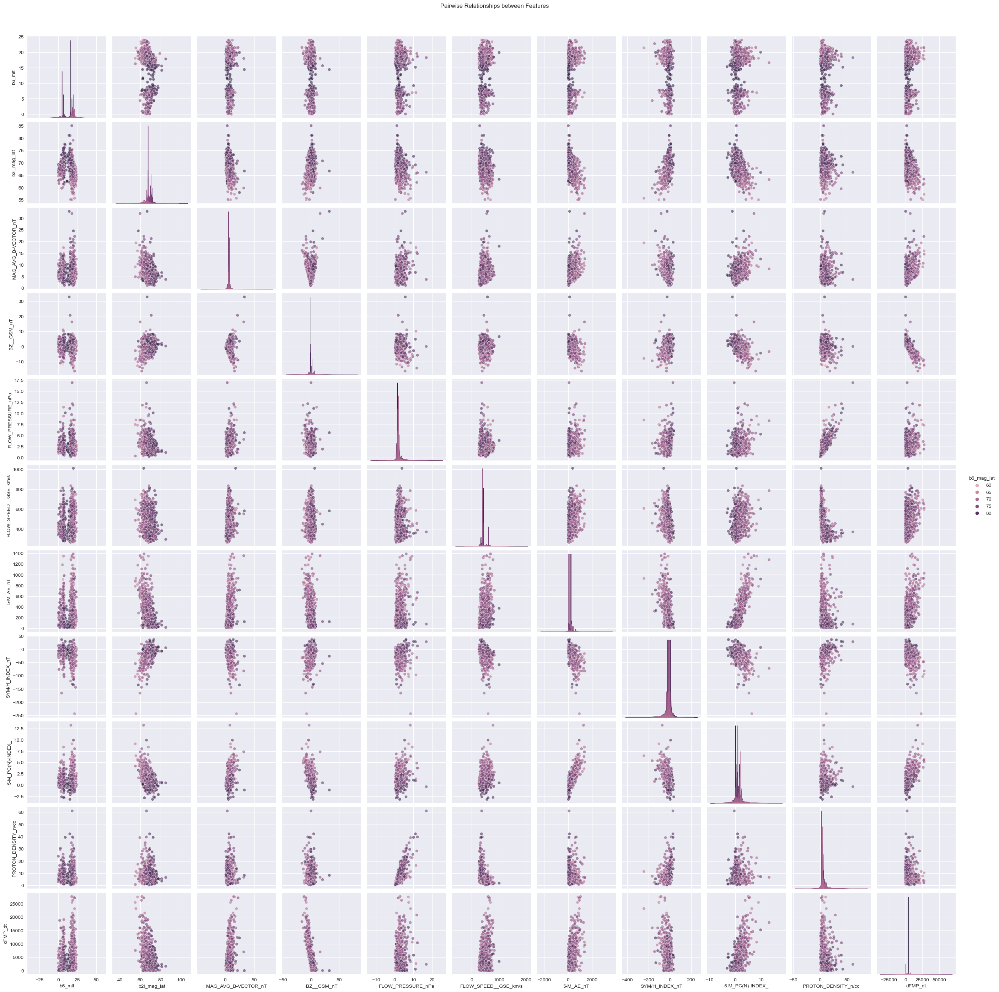


Training Random Forest...


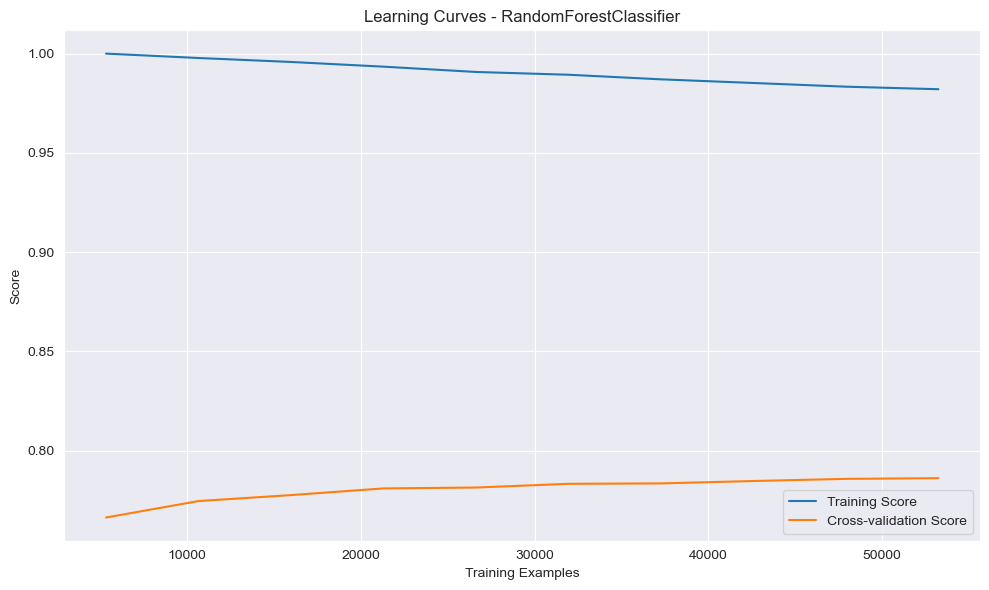

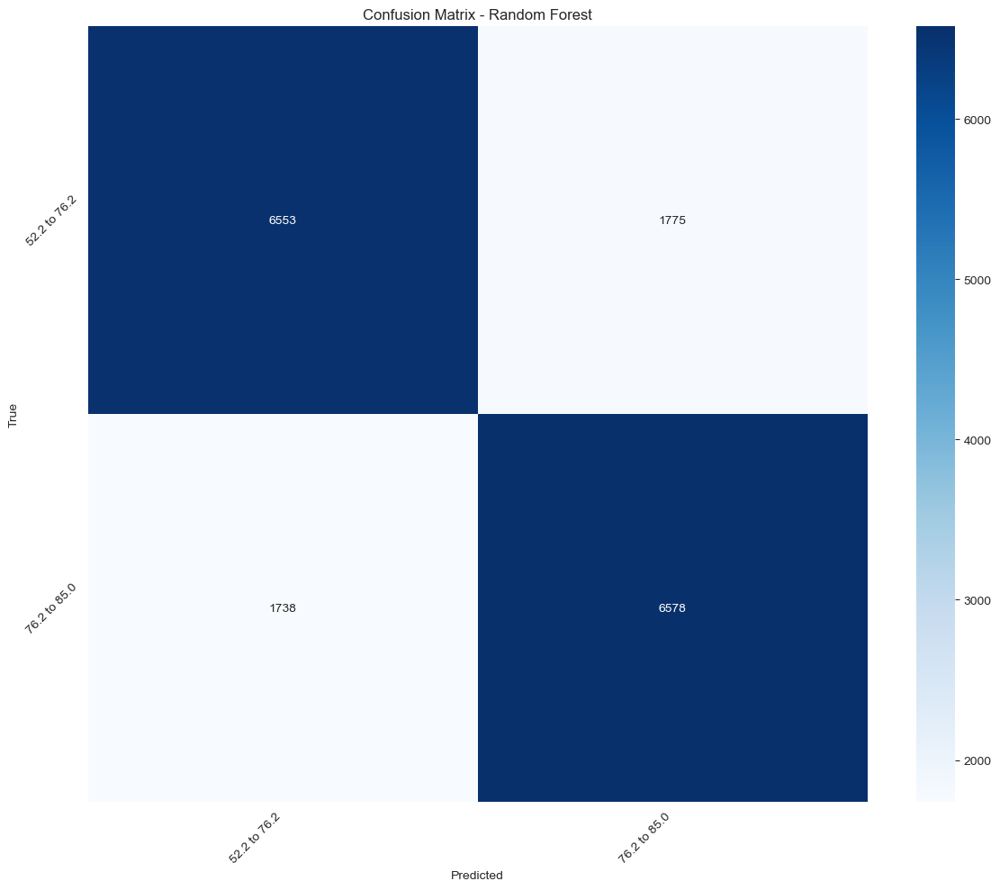

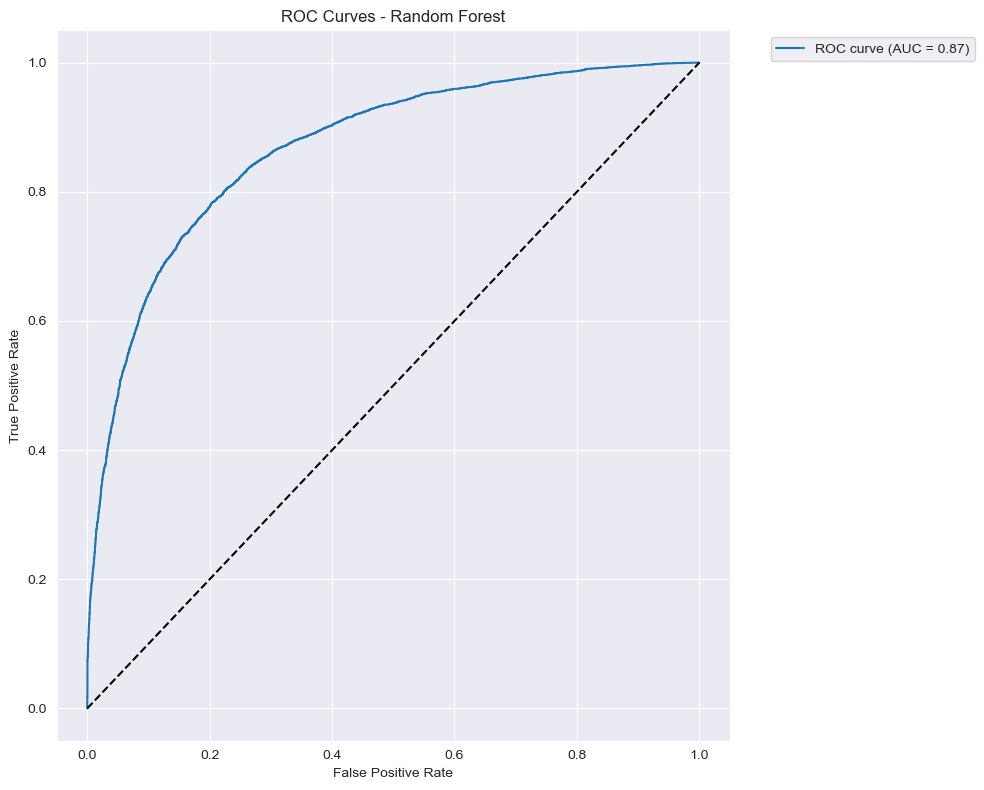

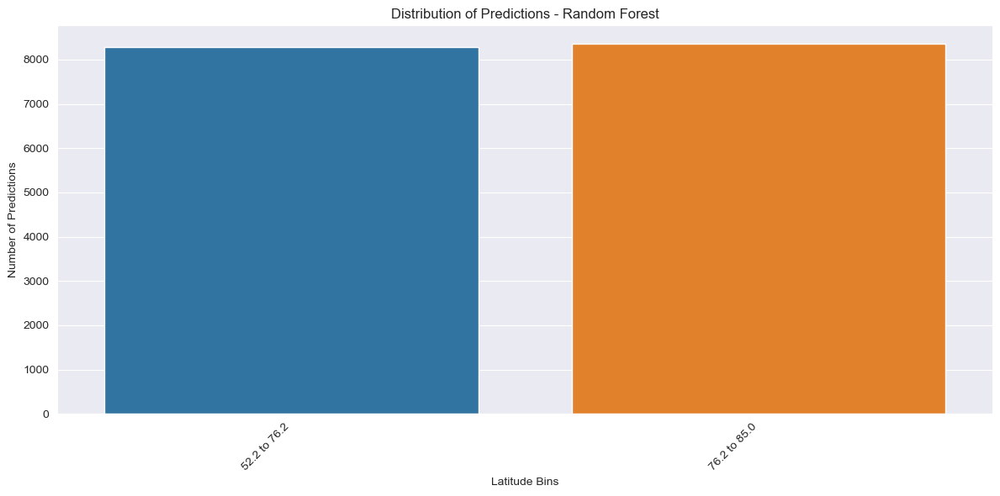

Best parameters for Random Forest: {'max_depth': 20, 'min_samples_split': 2, 'n_estimators': 200}

Classification Report:
              precision    recall  f1-score   support

52.2 to 76.2       0.79      0.79      0.79      8328
76.2 to 85.0       0.79      0.79      0.79      8316

    accuracy                           0.79     16644
   macro avg       0.79      0.79      0.79     16644
weighted avg       0.79      0.79      0.79     16644


Training Decision Tree...


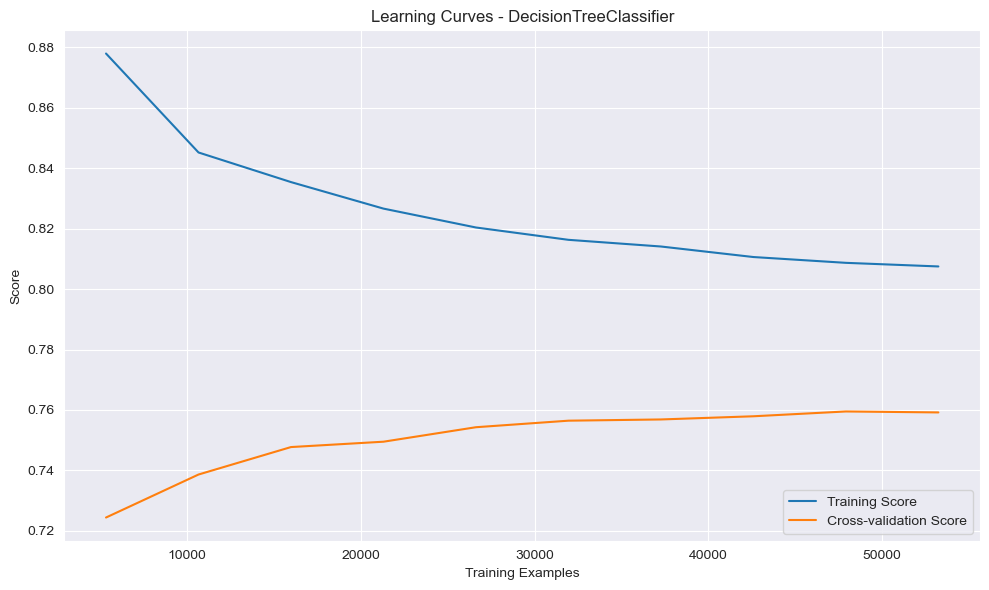

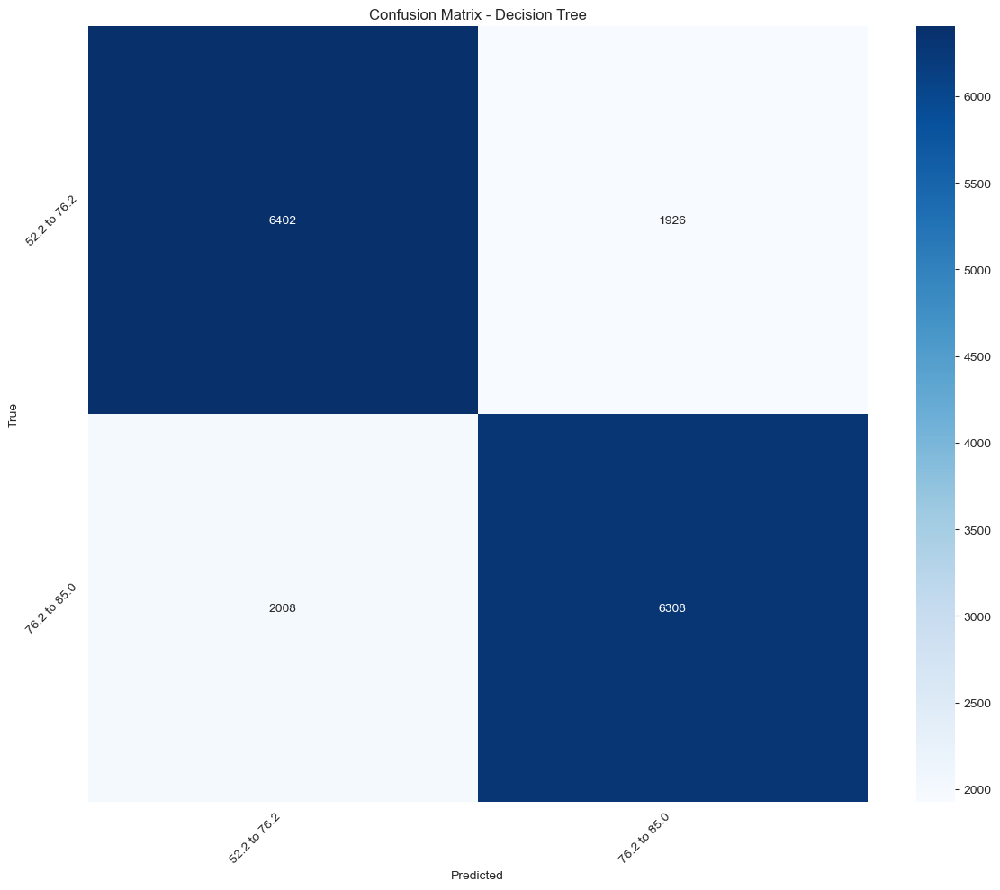

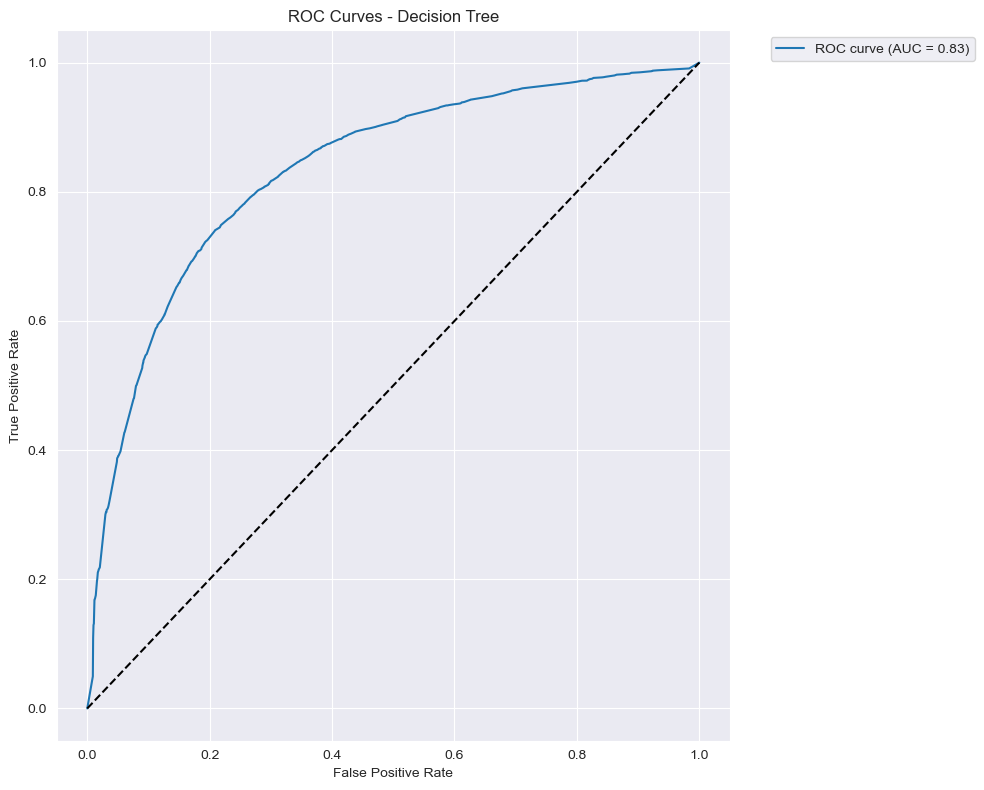

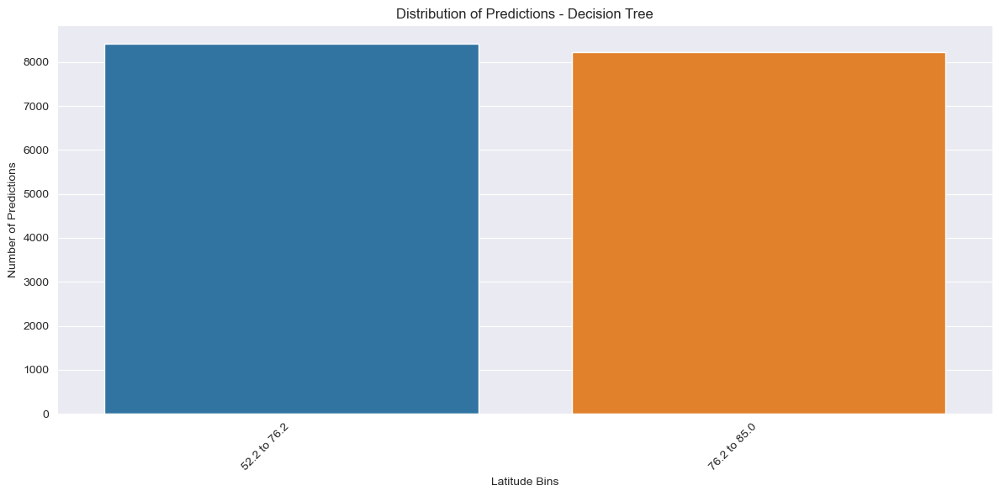

Best parameters for Decision Tree: {'max_depth': 10, 'min_samples_split': 5}

Classification Report:
              precision    recall  f1-score   support

52.2 to 76.2       0.76      0.77      0.76      8328
76.2 to 85.0       0.77      0.76      0.76      8316

    accuracy                           0.76     16644
   macro avg       0.76      0.76      0.76     16644
weighted avg       0.76      0.76      0.76     16644



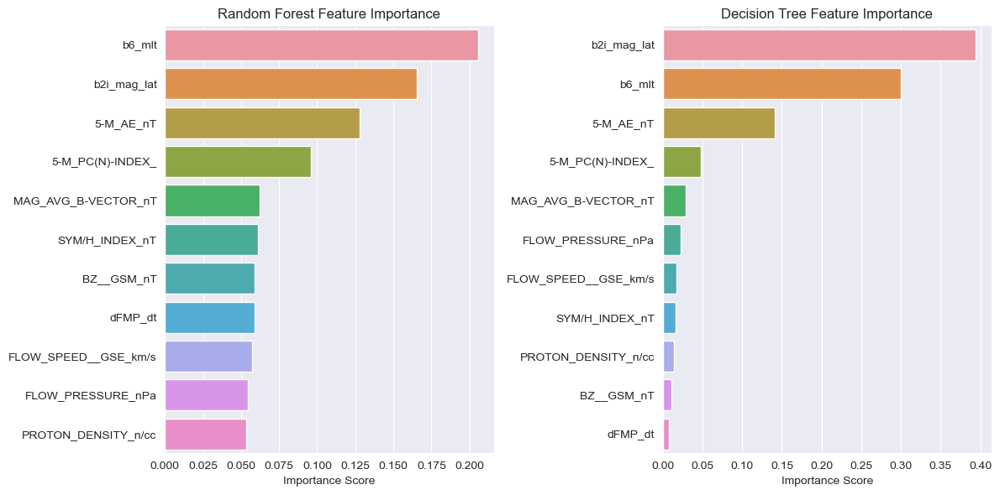


Training Neural Network...
Epoch 1/50
1665/1665 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.6998 - loss: 0.6600 - val_accuracy: 0.7591 - val_loss: 0.5591 - learning_rate: 0.0010
Epoch 2/50
1665/1665 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7371 - loss: 0.5794 - val_accuracy: 0.7656 - val_loss: 0.5329 - learning_rate: 0.0010
Epoch 3/50
1665/1665 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7419 - loss: 0.5616 - val_accuracy: 0.7630 - val_loss: 0.5253 - learning_rate: 0.0010
Epoch 4/50
1665/1665 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7412 - loss: 0.5519 - val_accuracy: 0.7696 - val_loss: 0.5164 - learning_rate: 0.0010
Epoch 5/50
1665/1665 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.7448 - loss: 0.5500 - val_accuracy: 0.7630 - val_loss: 0.5202 - learning_rate: 0.0010
Epoch 6/50
1665/1665 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.7482 - loss: 0.5434 - val_accuracy: 0.7673 - val_loss: 0.5201 - learning_rate: 0.0010
Epoch 7/50
1665/1665 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms

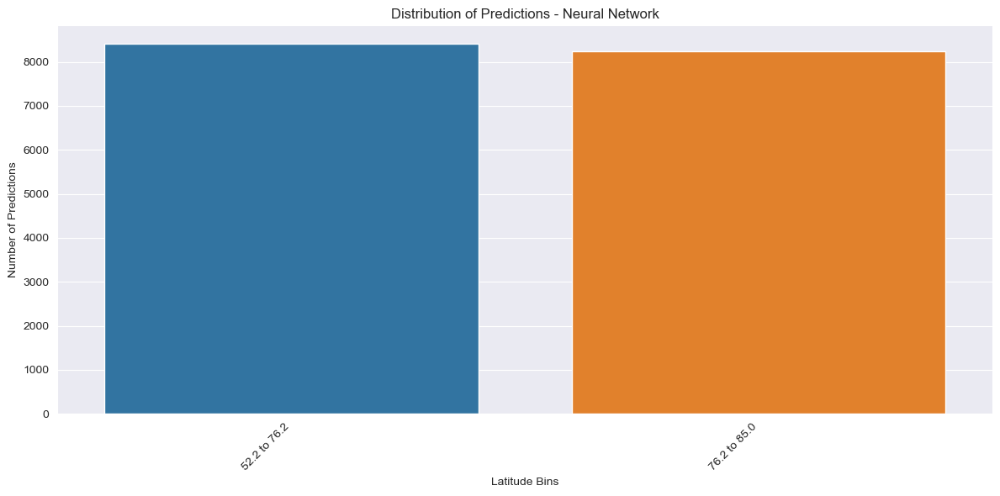

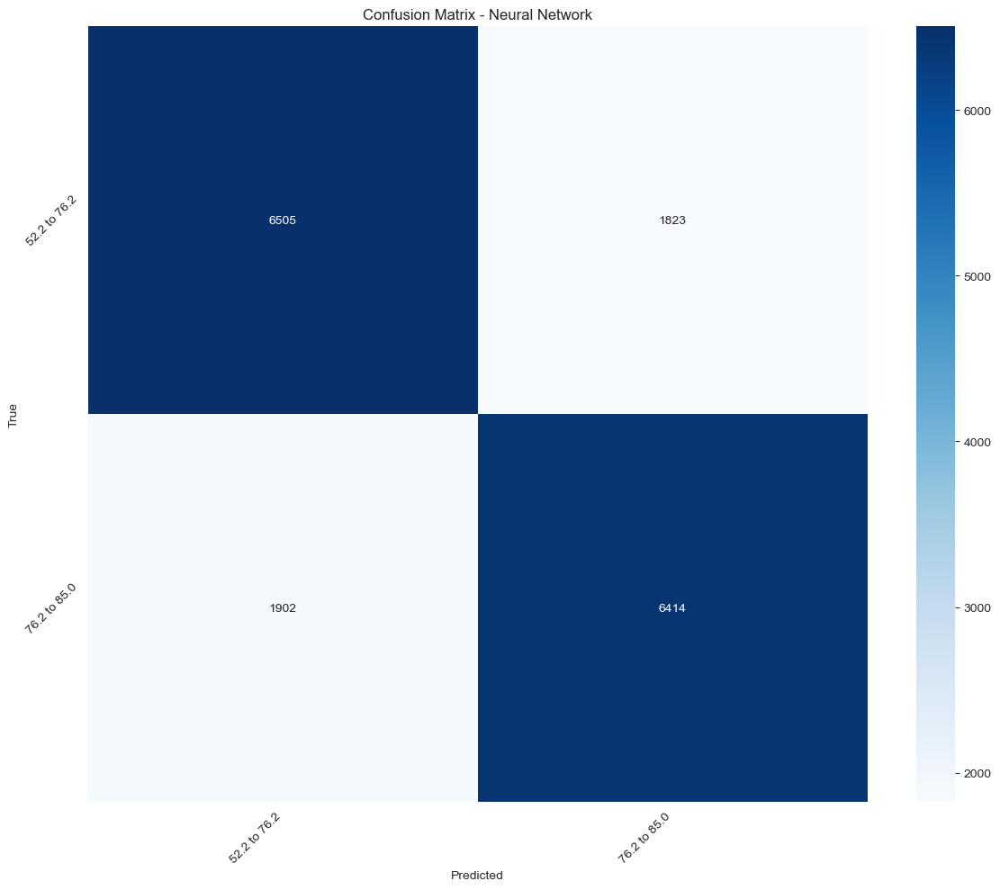

521/521 ━━━━━━━━━━━━━━━━━━━━ 0s 723us/step


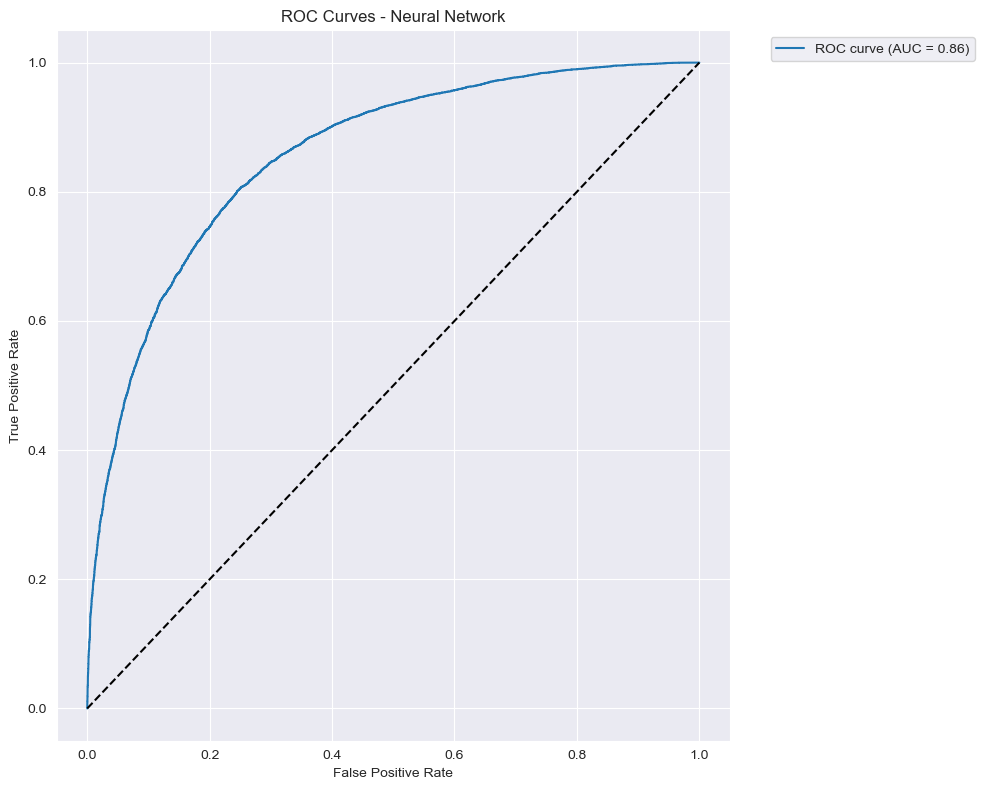


Neural Network Classification Report:
              precision    recall  f1-score   support

52.2 to 76.2       0.77      0.78      0.78      8328
76.2 to 85.0       0.78      0.77      0.77      8316

    accuracy                           0.78     16644
   macro avg       0.78      0.78      0.78     16644
weighted avg       0.78      0.78      0.78     16644



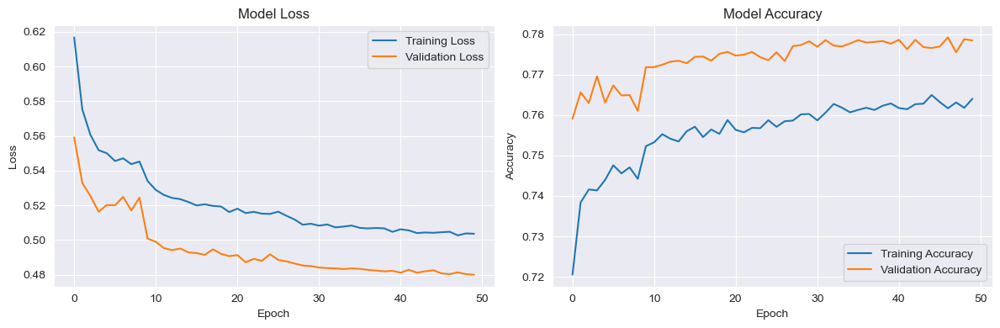

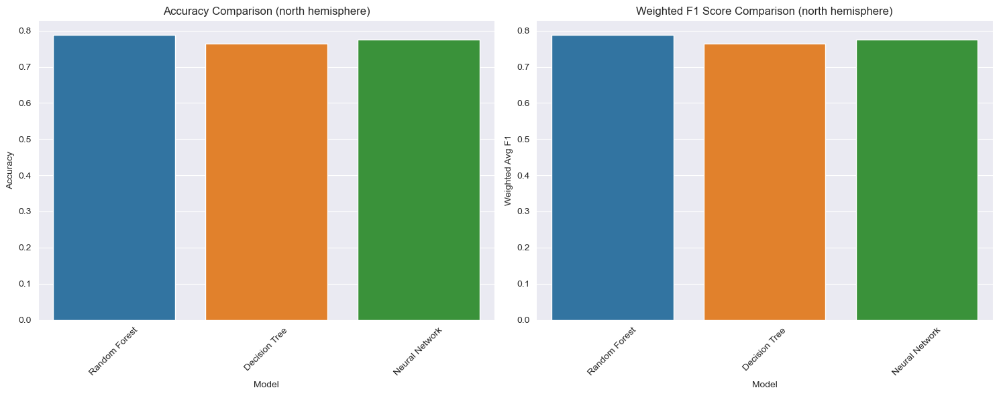


North Hemisphere Results:
            Model  Accuracy  Macro Avg F1  Weighted Avg F1
0   Random Forest  0.788933      0.788932         0.788932
1   Decision Tree  0.763639      0.763631         0.763632
2  Neural Network  0.776196      0.776189         0.776190

Training South Hemisphere Models...


/Users/beastxgamer/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1500 with 0 Axes>

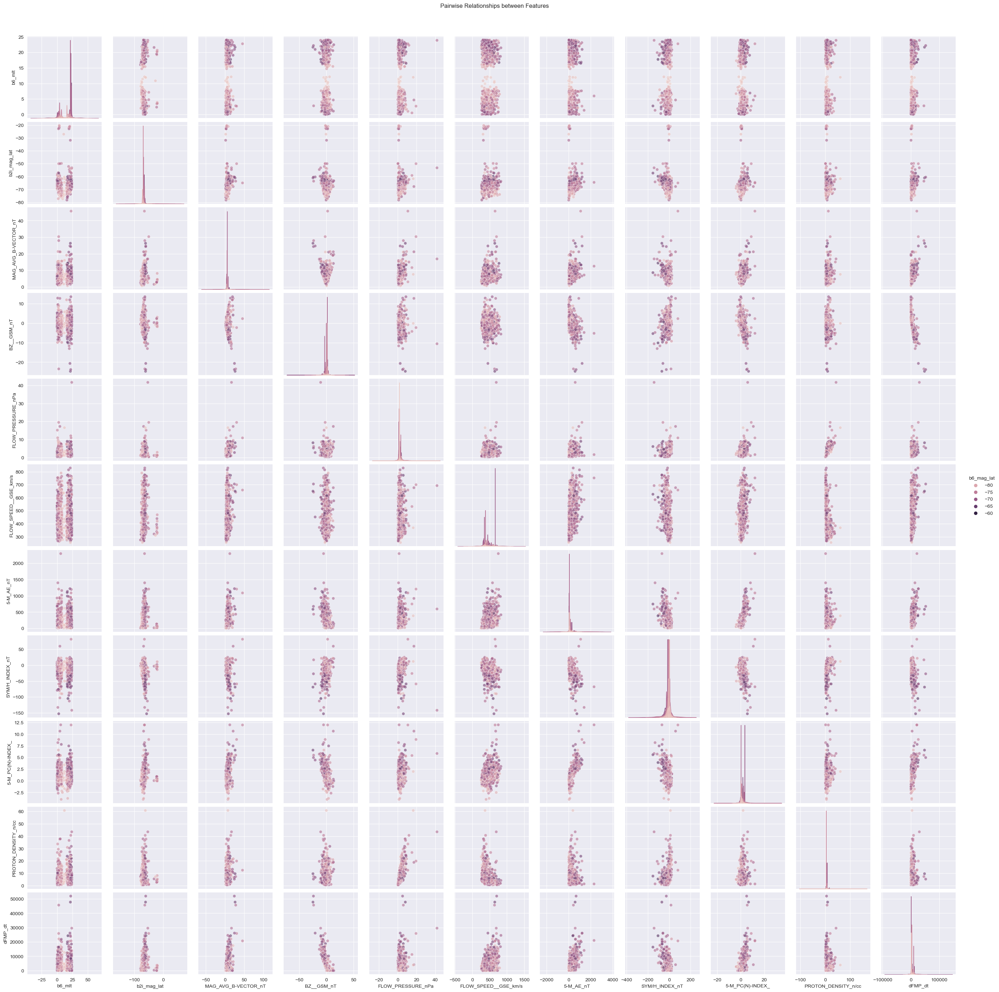


Training Random Forest...


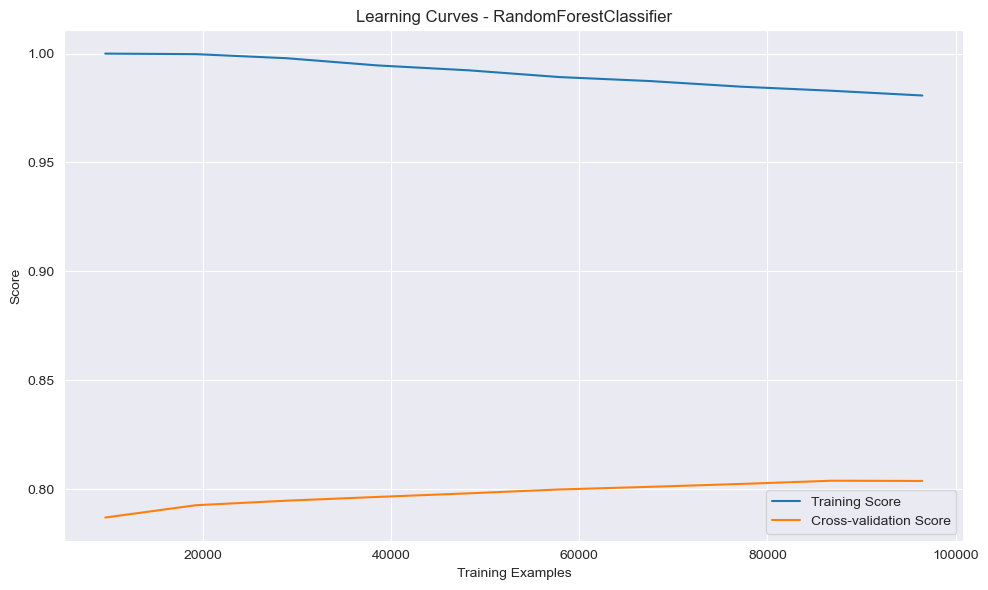

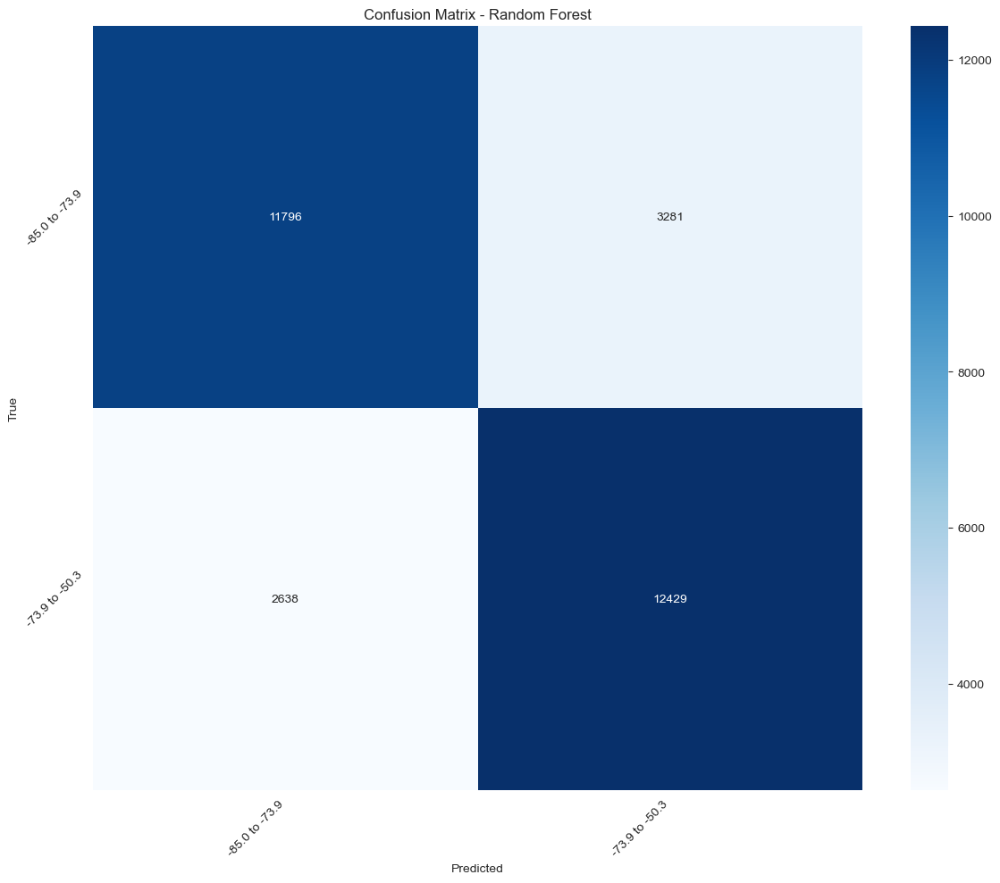

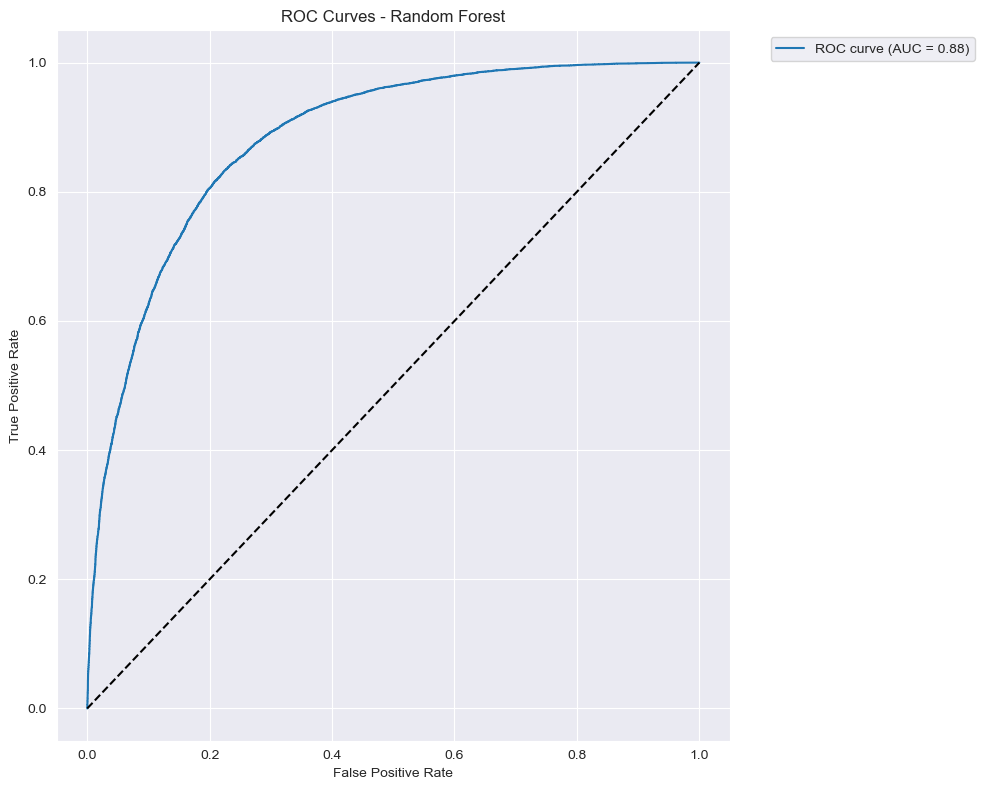

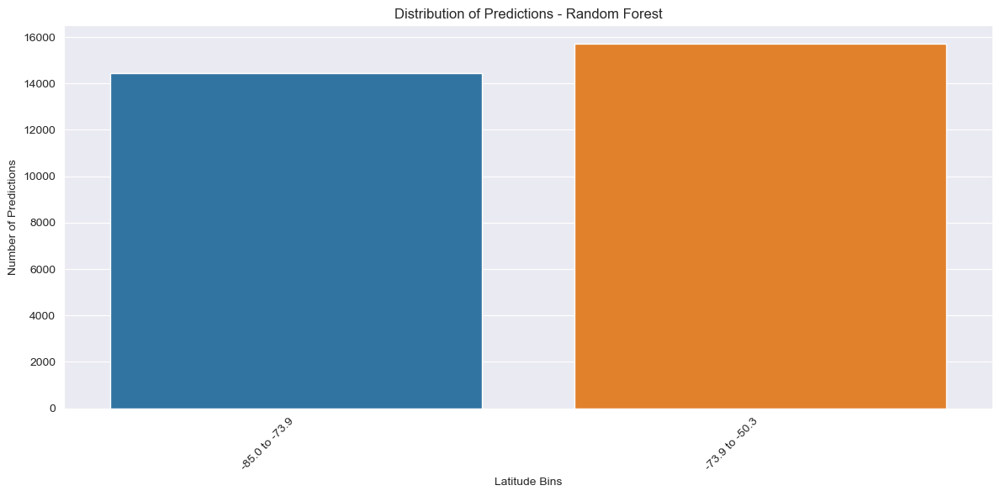

Best parameters for Random Forest: {'max_depth': 20, 'min_samples_split': 2, 'n_estimators': 200}

Classification Report:
                precision    recall  f1-score   support

-85.0 to -73.9       0.82      0.78      0.80     15077
-73.9 to -50.3       0.79      0.82      0.81     15067

      accuracy                           0.80     30144
     macro avg       0.80      0.80      0.80     30144
  weighted avg       0.80      0.80      0.80     30144


Training Decision Tree...


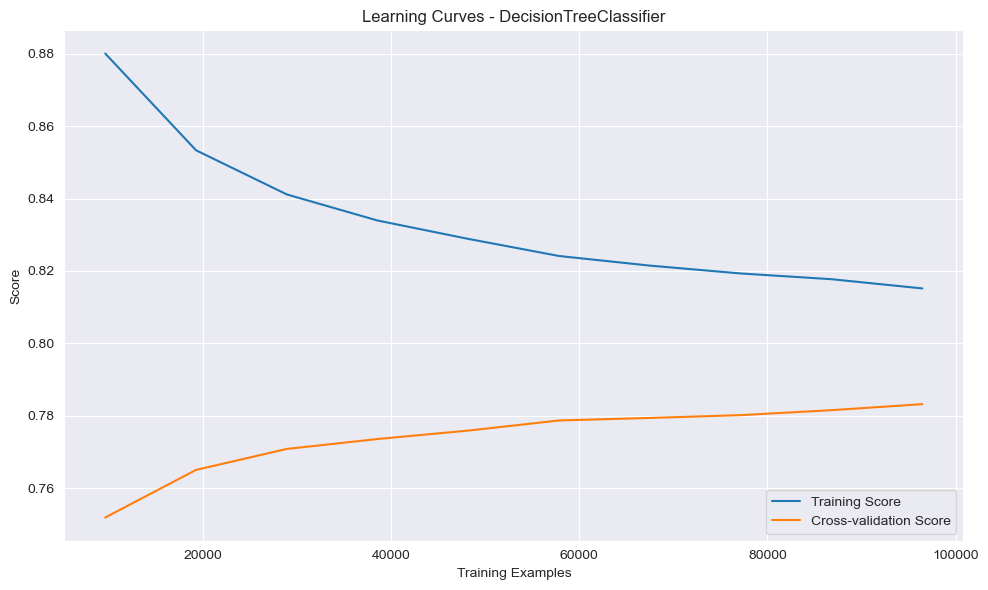

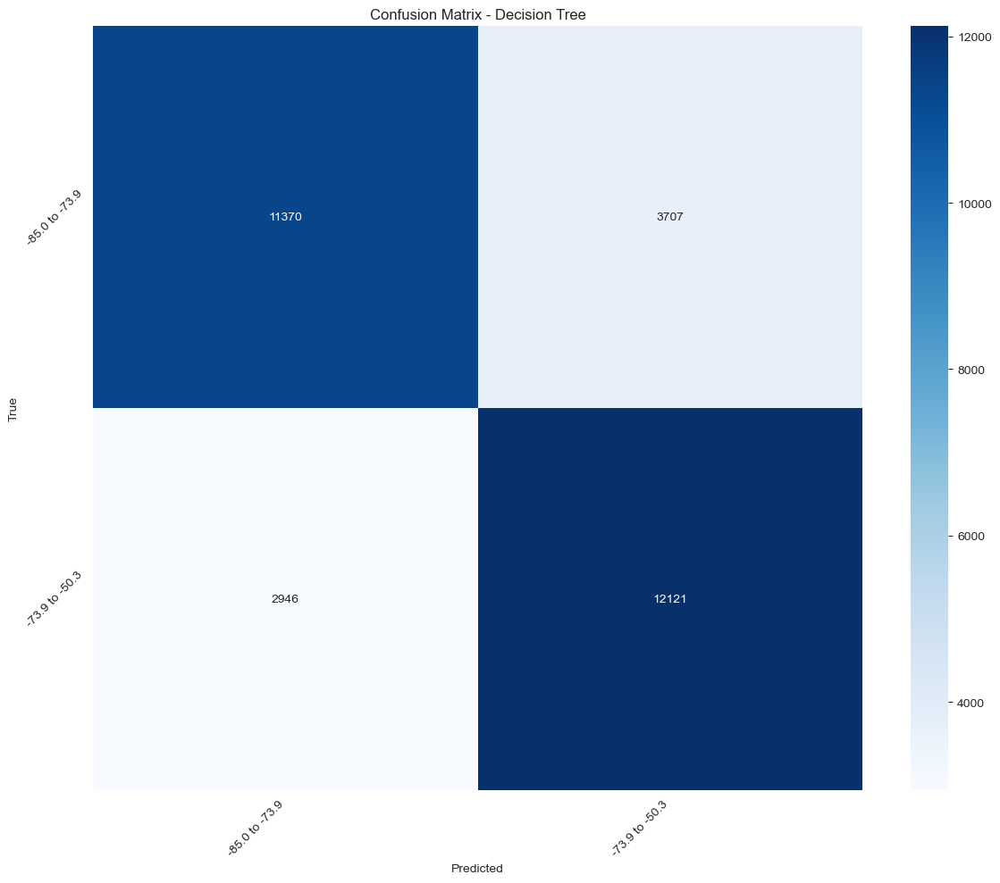

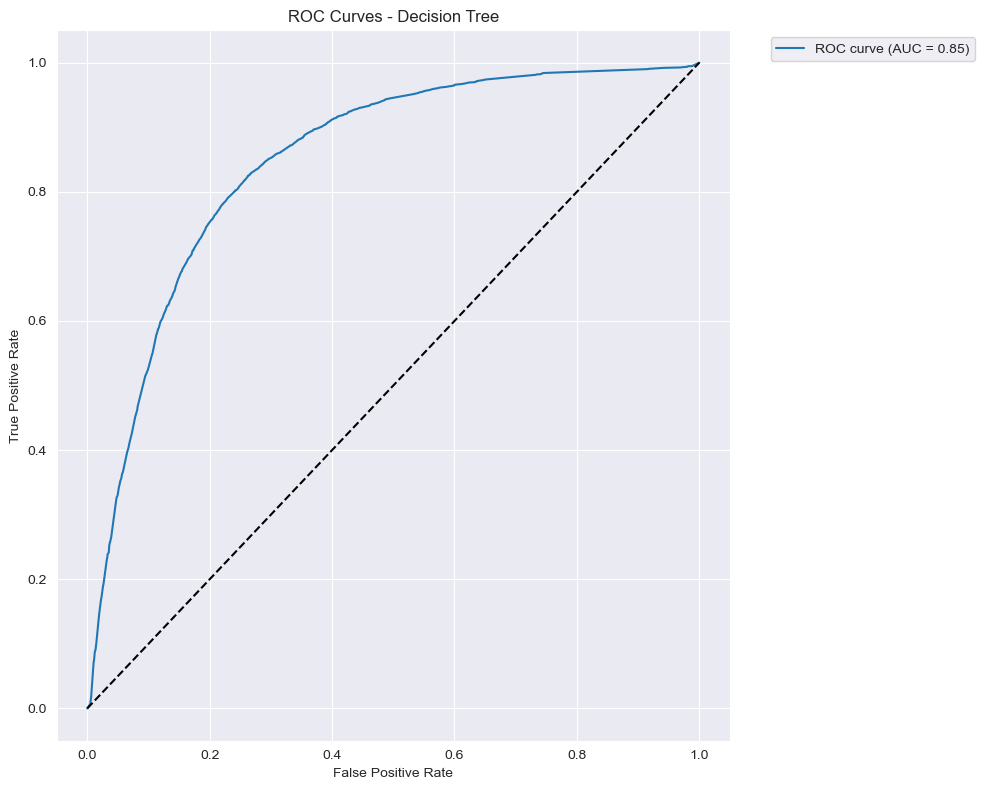

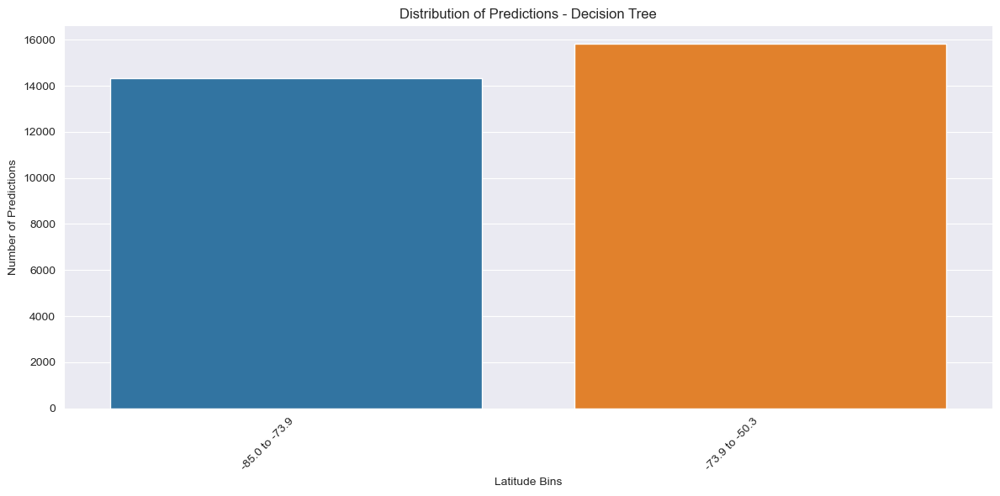

Best parameters for Decision Tree: {'max_depth': 10, 'min_samples_split': 5}

Classification Report:
                precision    recall  f1-score   support

-85.0 to -73.9       0.79      0.75      0.77     15077
-73.9 to -50.3       0.77      0.80      0.78     15067

      accuracy                           0.78     30144
     macro avg       0.78      0.78      0.78     30144
  weighted avg       0.78      0.78      0.78     30144



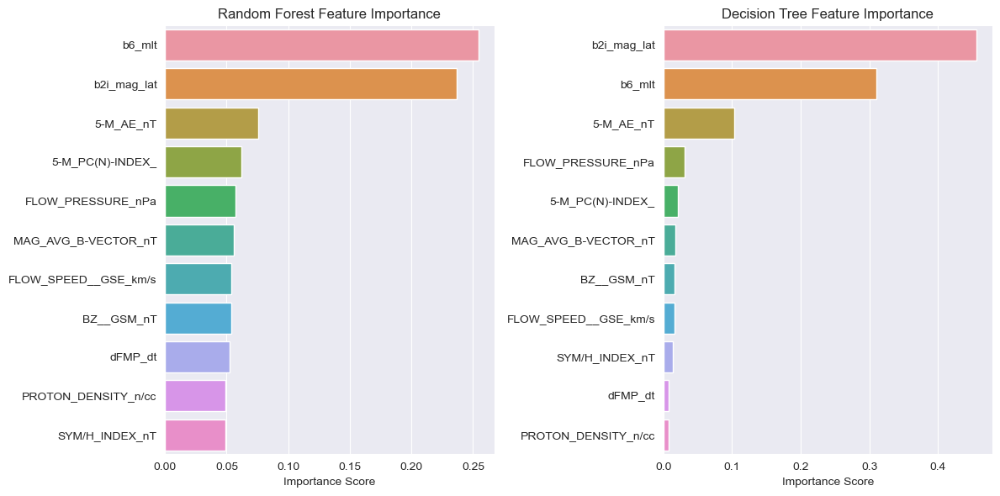


Training Neural Network...
Epoch 1/50
3015/3015 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.7226 - loss: 0.6195 - val_accuracy: 0.7800 - val_loss: 0.5153 - learning_rate: 0.0010
Epoch 2/50
3015/3015 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7592 - loss: 0.5417 - val_accuracy: 0.7815 - val_loss: 0.4975 - learning_rate: 0.0010
Epoch 3/50
3015/3015 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7617 - loss: 0.5262 - val_accuracy: 0.7884 - val_loss: 0.4892 - learning_rate: 0.0010
Epoch 4/50
3015/3015 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7657 - loss: 0.5225 - val_accuracy: 0.7741 - val_loss: 0.5112 - learning_rate: 0.0010
Epoch 5/50
3015/3015 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.7645 - loss: 0.5225 - val_accuracy: 0.7894 - val_loss: 0.4872 - learning_rate: 0.0010
Epoch 6/50
3015/3015 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.7673 - loss: 0.5191 - val_accuracy: 0.7855 - val_loss: 0.4914 - learning_rate: 0.0010
Epoch 7/50
3015/3015 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms

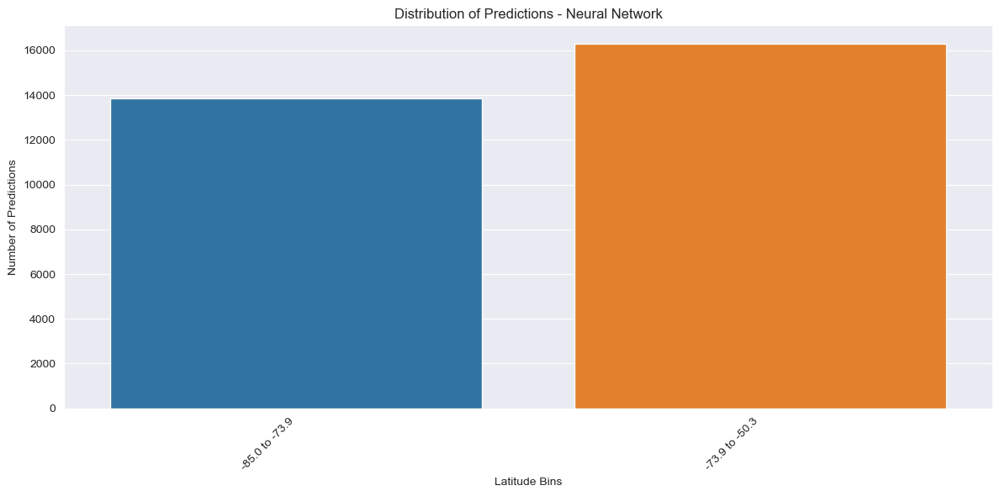

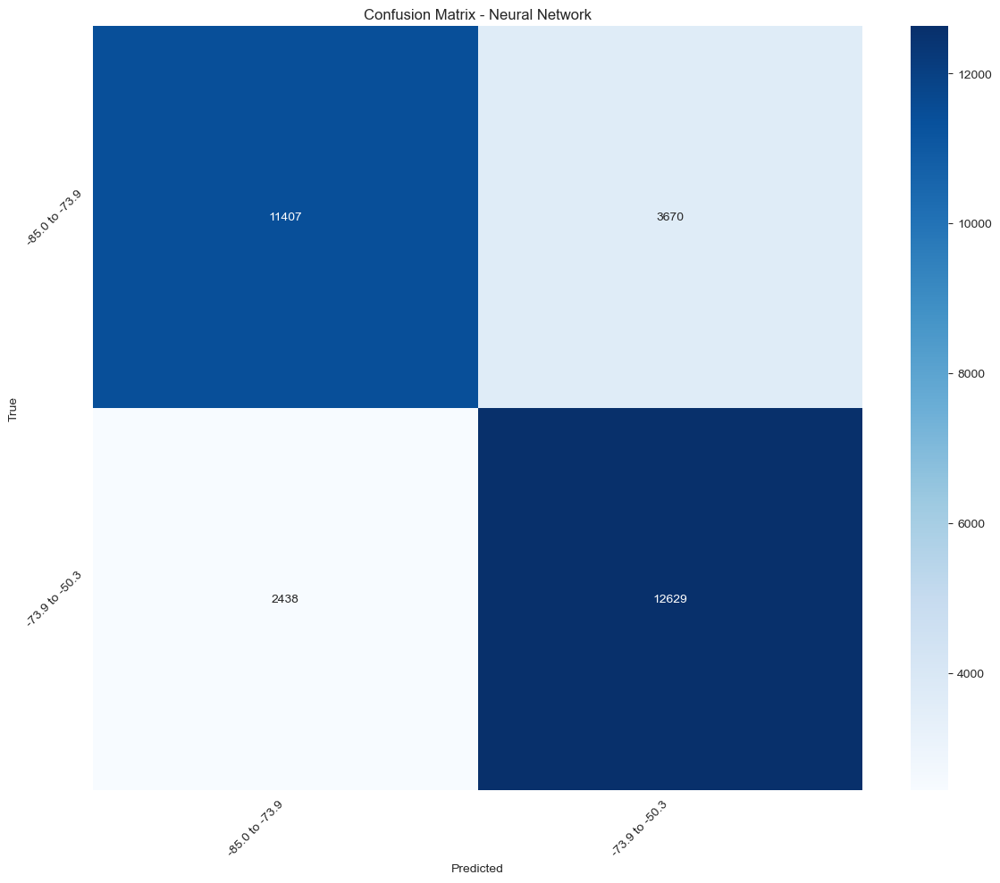

942/942 ━━━━━━━━━━━━━━━━━━━━ 1s 552us/step


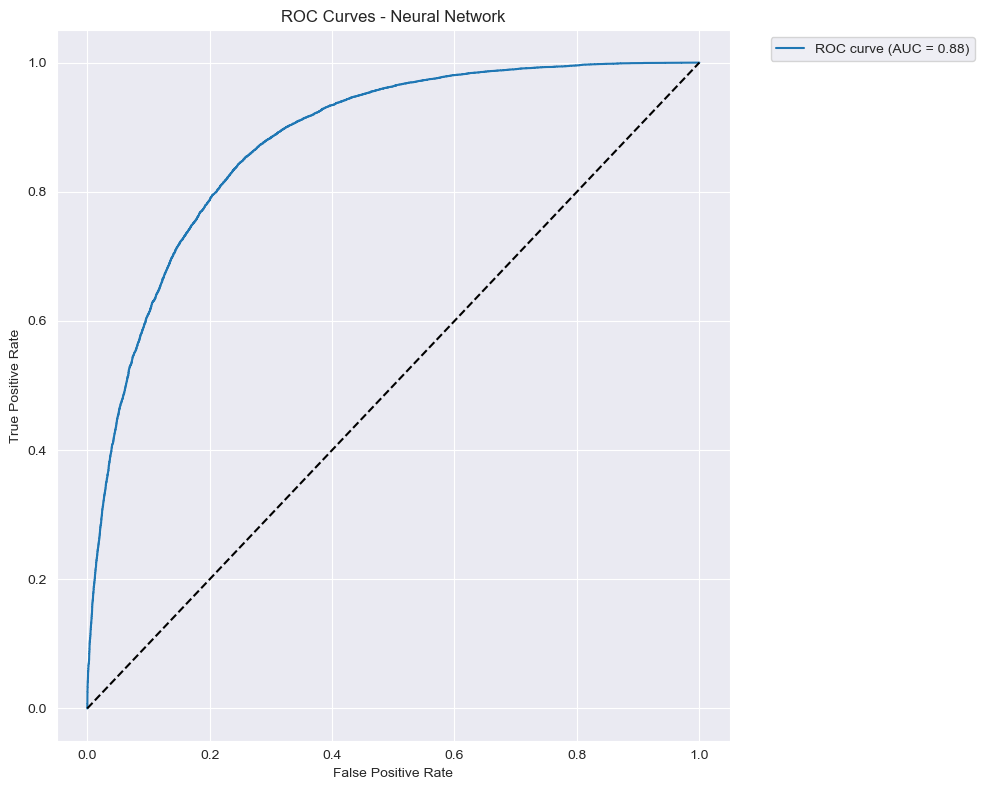


Neural Network Classification Report:
                precision    recall  f1-score   support

-85.0 to -73.9       0.82      0.76      0.79     15077
-73.9 to -50.3       0.77      0.84      0.81     15067

      accuracy                           0.80     30144
     macro avg       0.80      0.80      0.80     30144
  weighted avg       0.80      0.80      0.80     30144



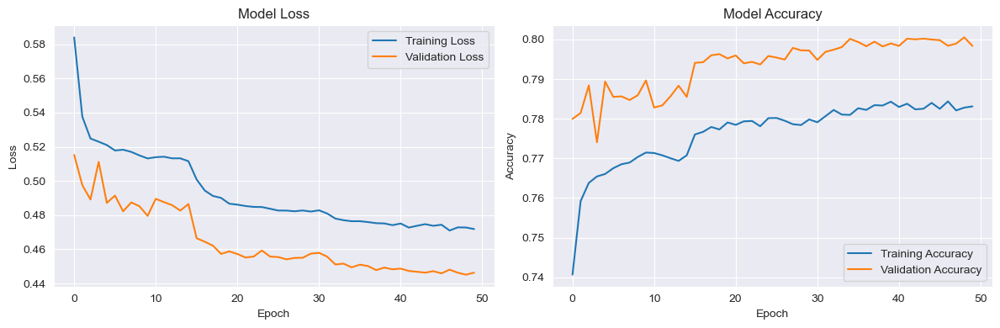

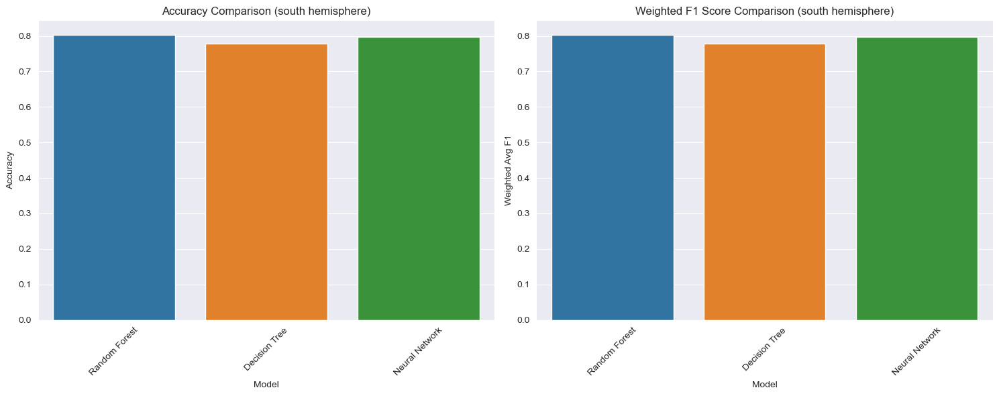


South Hemisphere Results:
            Model  Accuracy  Macro Avg F1  Weighted Avg F1
0   Random Forest  0.803643      0.803556         0.803555
1   Decision Tree  0.779293      0.779156         0.779154
2  Neural Network  0.797373      0.797039         0.797036


In [20]:
# Nightside Testing #
# changeable features and target
features_nightside = [
    'b6_mlt', 'b2i_mag_lat', 'MAG_AVG_B-VECTOR_nT',
       'BZ__GSM_nT', 'FLOW_PRESSURE_nPa', 'FLOW_SPEED__GSE_km/s', '5-M_AE_nT',
       'SYM/H_INDEX_nT', '5-M_PC(N)-INDEX_', 'PROTON_DENSITY_n/cc', 'dFMP_dt'
]
target_nightside = 'b6_mag_lat'

print("Training North Hemisphere Models...")
north_results, north_models, north_scaler, north_edges, north_labels, north_history = train_classification_models(nightsideN_df, features_nightside, target_nightside, 'north', n_bins=2)
print("\nNorth Hemisphere Results:")
print(north_results)

print("\nTraining South Hemisphere Models...")
south_results, south_models, south_scaler, south_edges, south_labels, south_history = train_classification_models(nightsideS_df, features_nightside, target_nightside, 'south', n_bins=2)
print("\nSouth Hemisphere Results:")
print(south_results)

Training North Hemisphere Models...


/Users/beastxgamer/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1500 with 0 Axes>

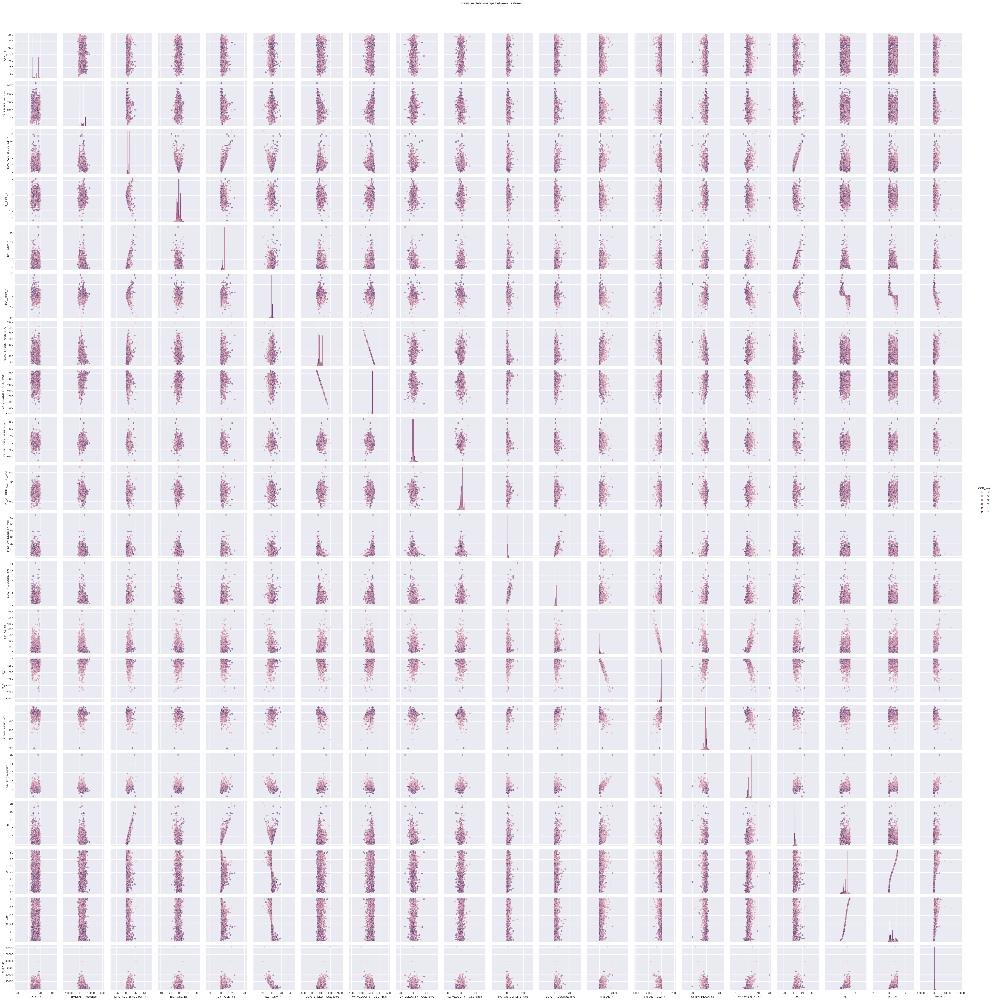


Training Random Forest...


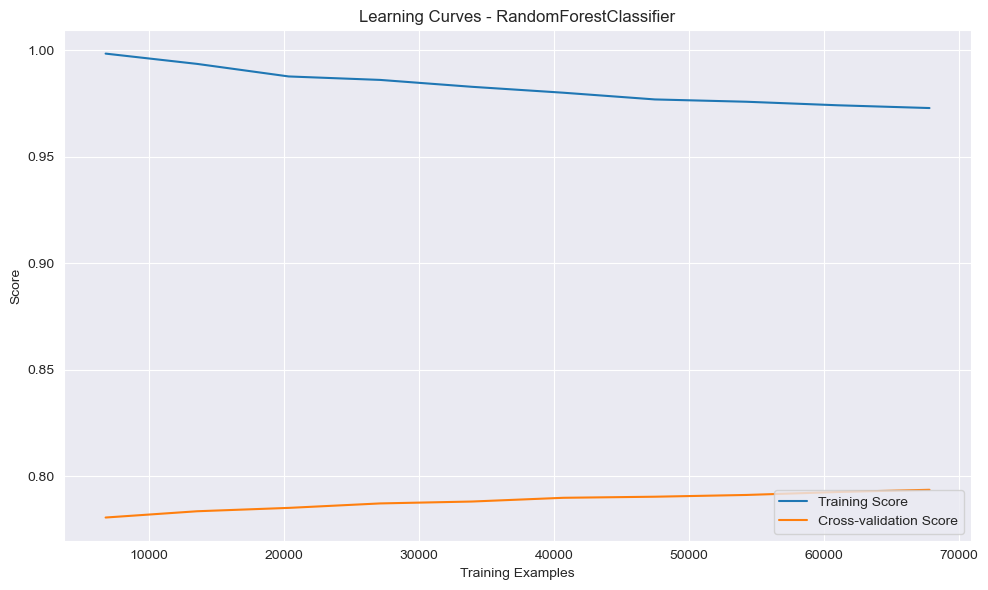

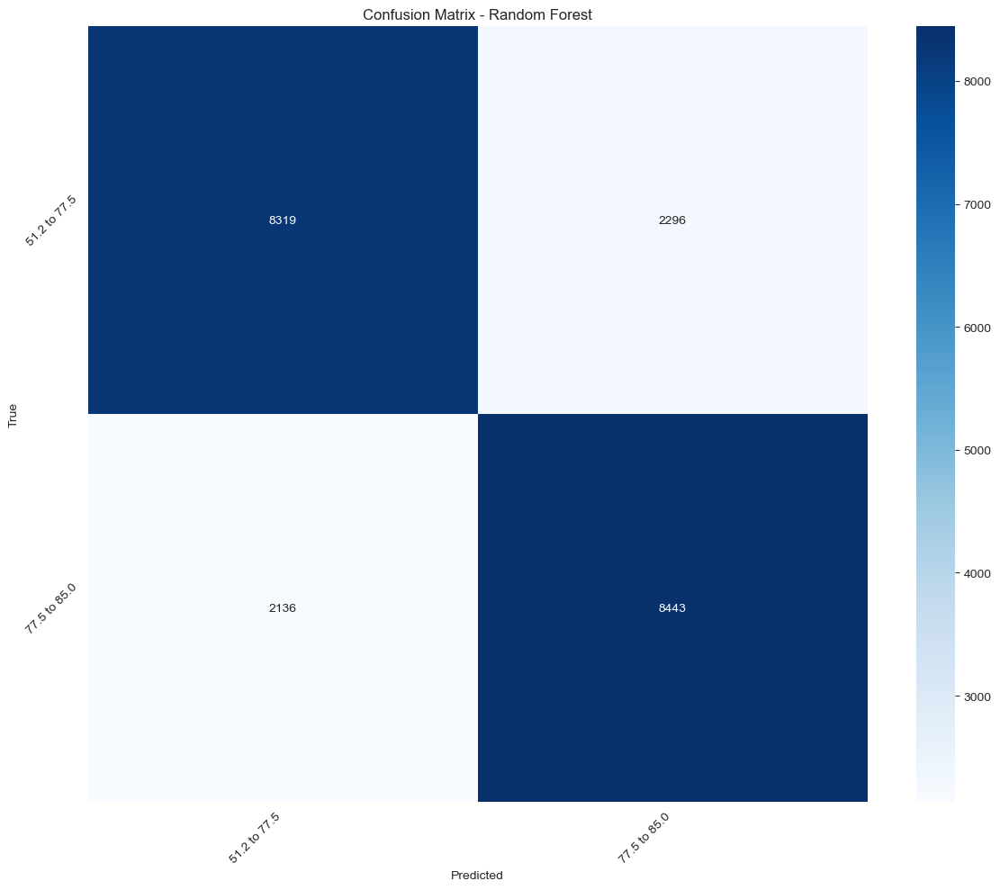

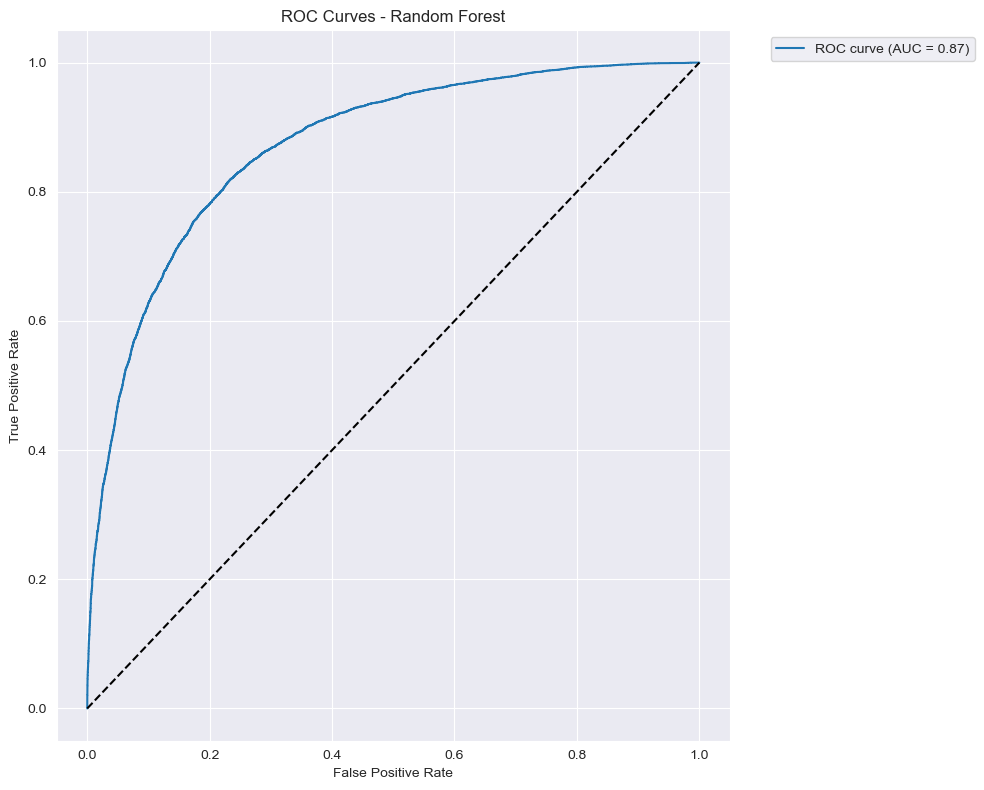

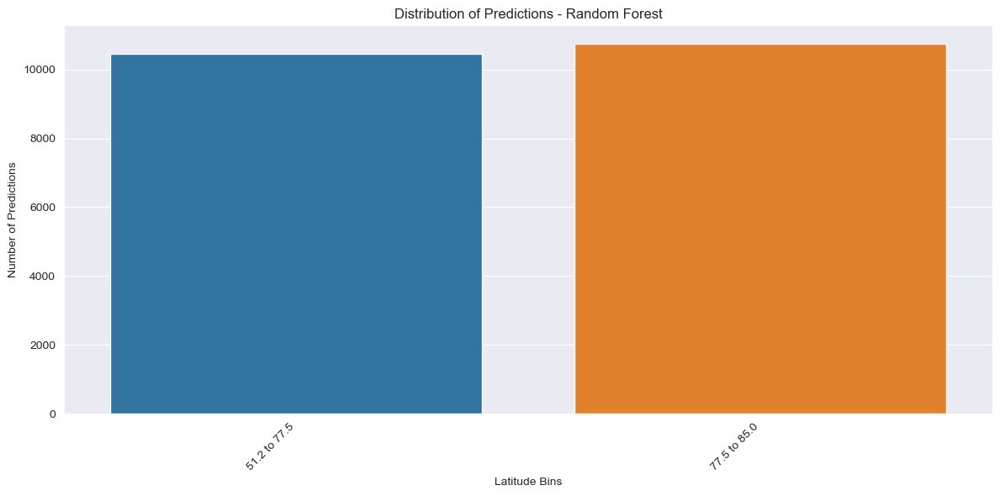

Best parameters for Random Forest: {'max_depth': 20, 'min_samples_split': 2, 'n_estimators': 200}

Classification Report:
              precision    recall  f1-score   support

51.2 to 77.5       0.80      0.78      0.79     10615
77.5 to 85.0       0.79      0.80      0.79     10579

    accuracy                           0.79     21194
   macro avg       0.79      0.79      0.79     21194
weighted avg       0.79      0.79      0.79     21194


Training Decision Tree...


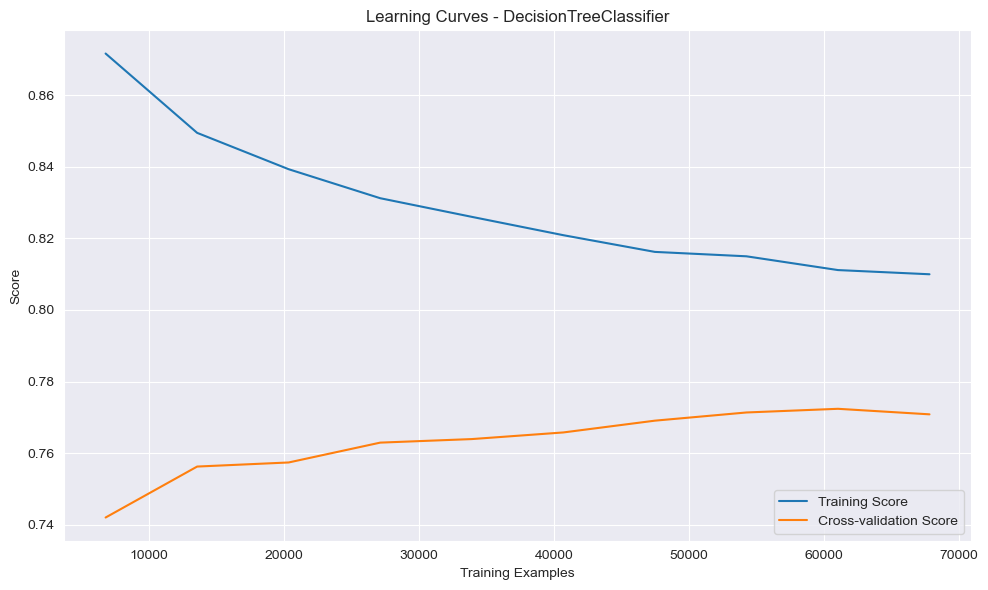

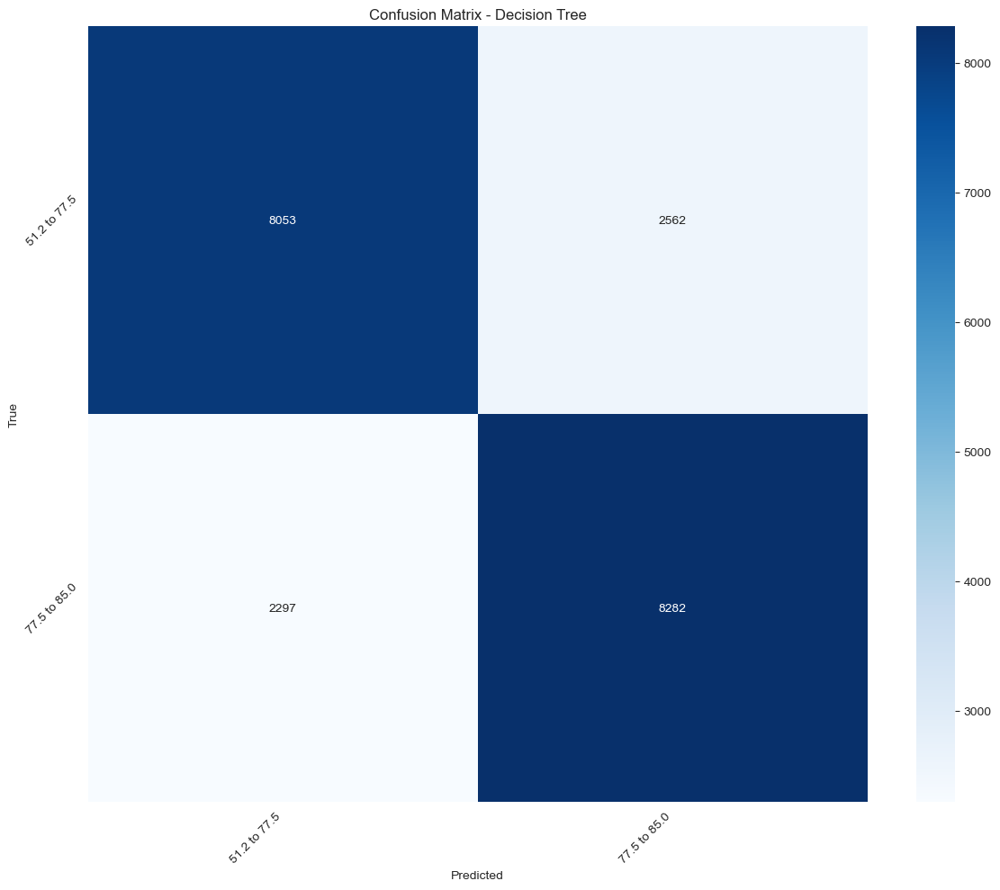

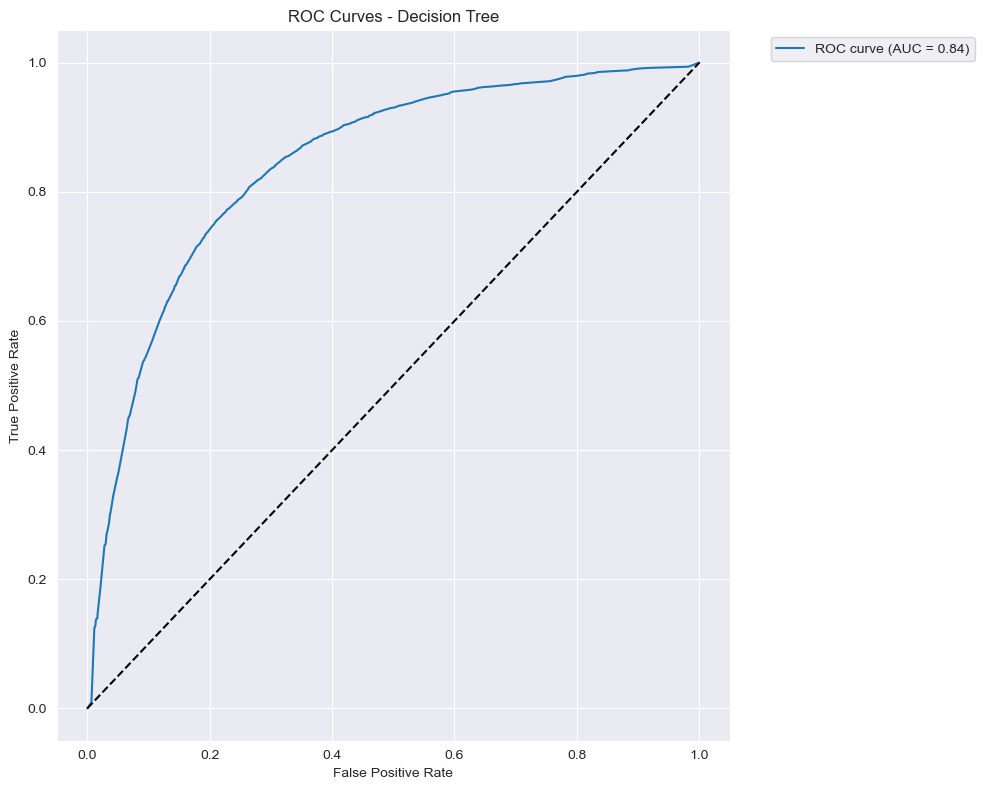

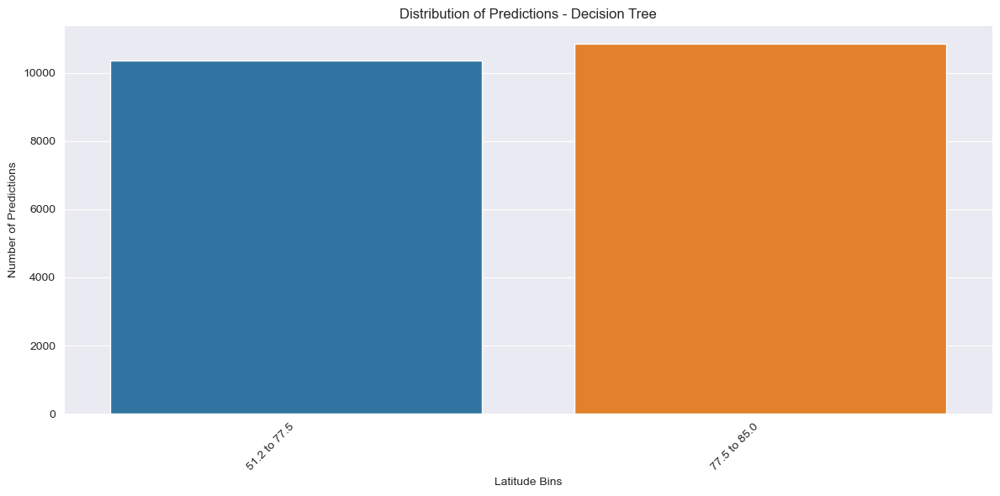

Best parameters for Decision Tree: {'max_depth': 10, 'min_samples_split': 2}

Classification Report:
              precision    recall  f1-score   support

51.2 to 77.5       0.78      0.76      0.77     10615
77.5 to 85.0       0.76      0.78      0.77     10579

    accuracy                           0.77     21194
   macro avg       0.77      0.77      0.77     21194
weighted avg       0.77      0.77      0.77     21194



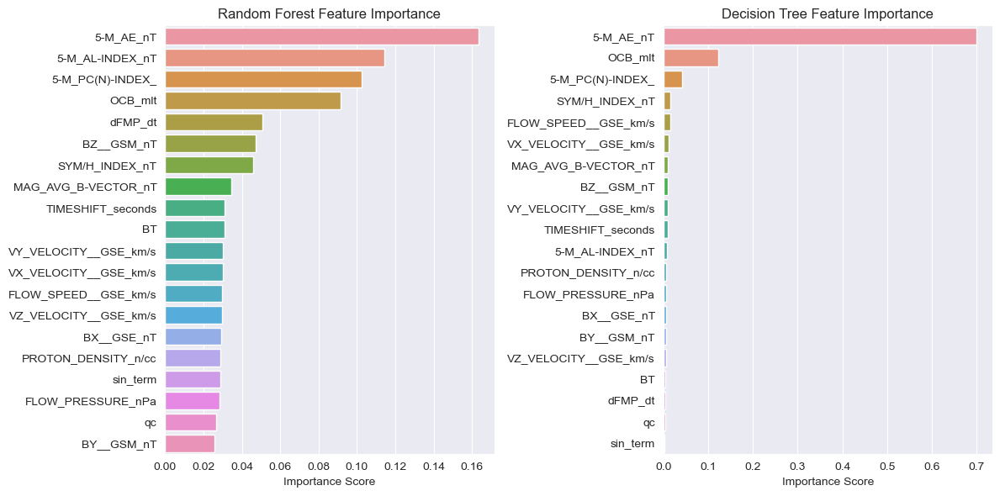


Training Neural Network...
Epoch 1/50
2120/2120 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - accuracy: 0.7404 - loss: 0.6043 - val_accuracy: 0.7759 - val_loss: 0.5288 - learning_rate: 0.0010
Epoch 2/50
2120/2120 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7684 - loss: 0.5358 - val_accuracy: 0.7751 - val_loss: 0.5115 - learning_rate: 0.0010
Epoch 3/50
2120/2120 ━━━━━━━━━━━━━━━━━━━━ 284s 134ms/step - accuracy: 0.7687 - loss: 0.5210 - val_accuracy: 0.7786 - val_loss: 0.4995 - learning_rate: 0.0010
Epoch 4/50
2120/2120 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7674 - loss: 0.5148 - val_accuracy: 0.7784 - val_loss: 0.4966 - learning_rate: 0.0010
Epoch 5/50
2120/2120 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7715 - loss: 0.5105 - val_accuracy: 0.7829 - val_loss: 0.4916 - learning_rate: 0.0010
Epoch 6/50
2120/2120 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7730 - loss: 0.5081 - val_accuracy: 0.7805 - val_loss: 0.4954 - learning_rate: 0.0010
Epoch 7/50
2120/2120 ━━━━━━━━━━━━━━━━━━━━ 5s

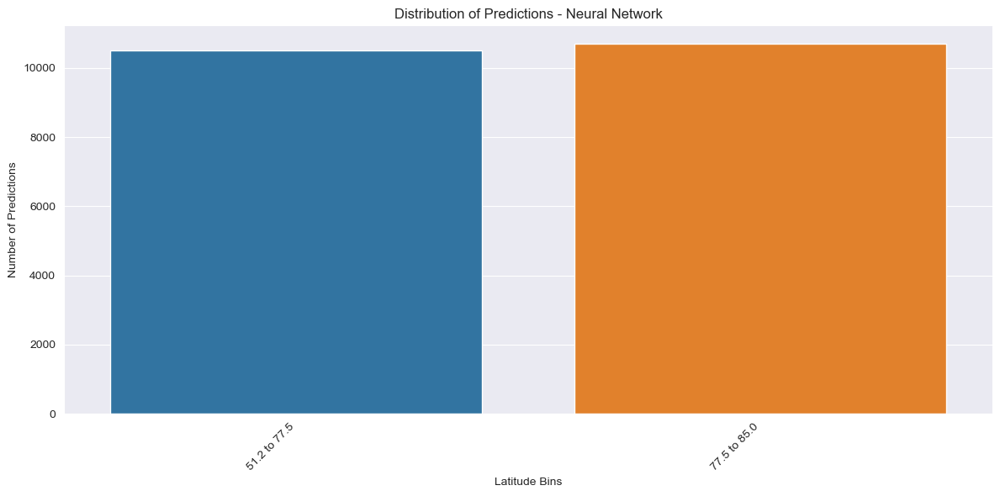

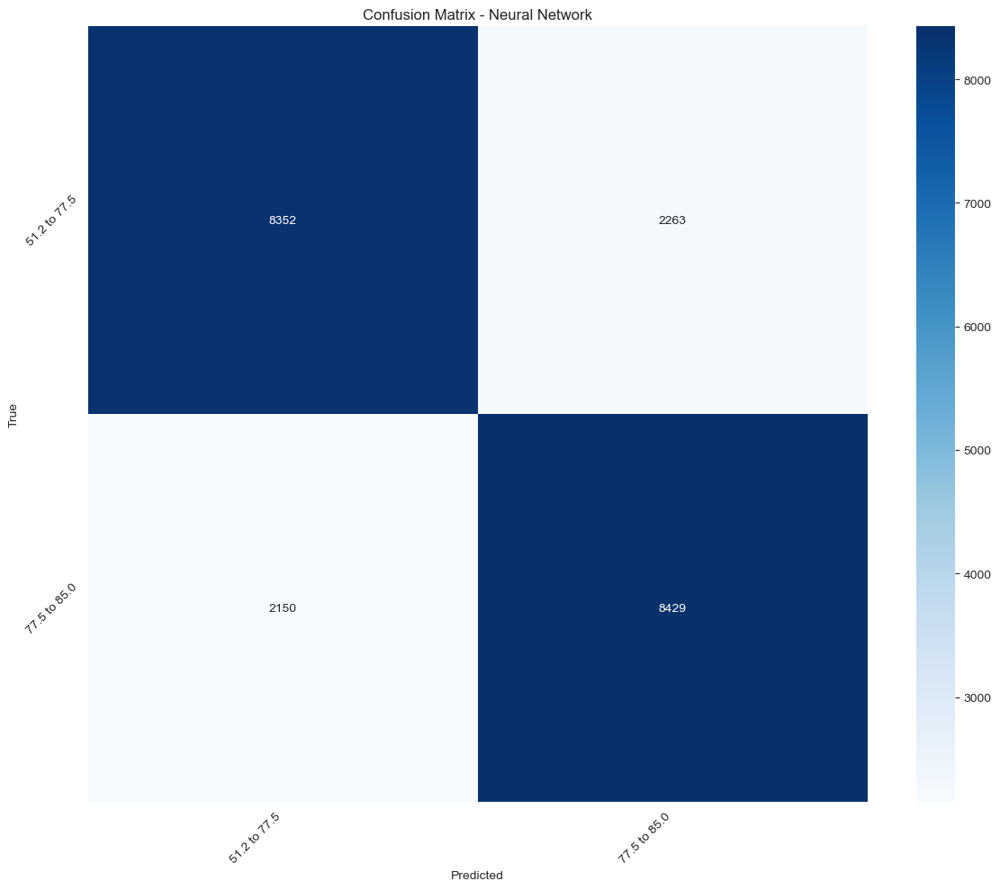

663/663 ━━━━━━━━━━━━━━━━━━━━ 0s 447us/step


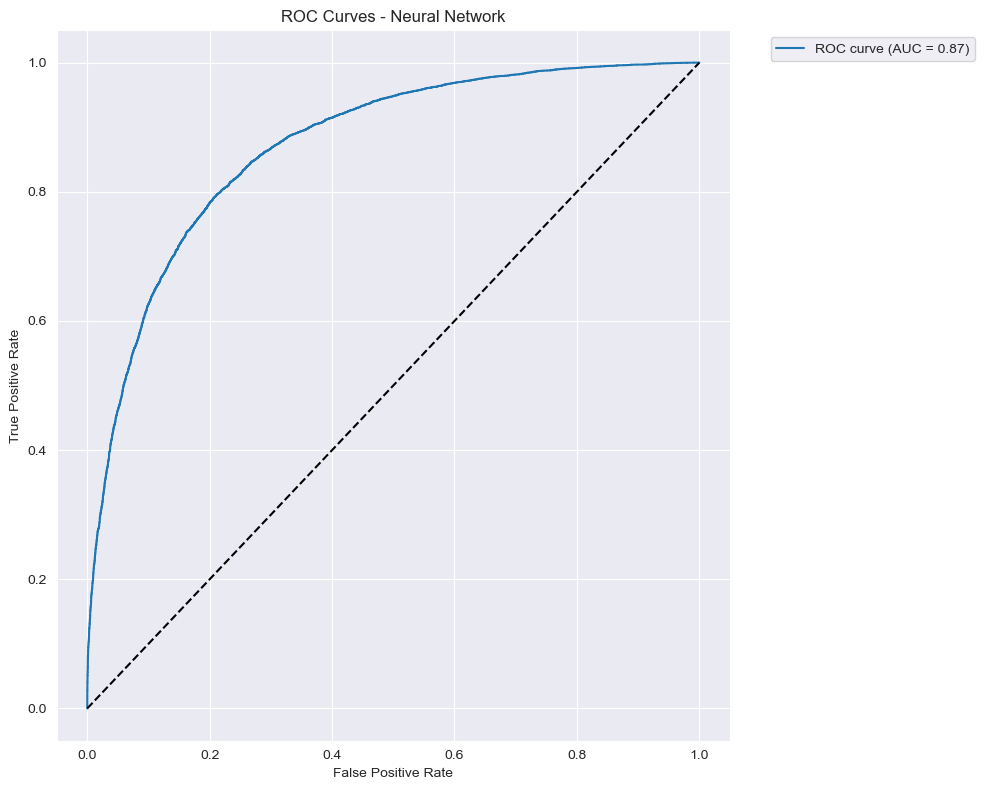


Neural Network Classification Report:
              precision    recall  f1-score   support

51.2 to 77.5       0.80      0.79      0.79     10615
77.5 to 85.0       0.79      0.80      0.79     10579

    accuracy                           0.79     21194
   macro avg       0.79      0.79      0.79     21194
weighted avg       0.79      0.79      0.79     21194



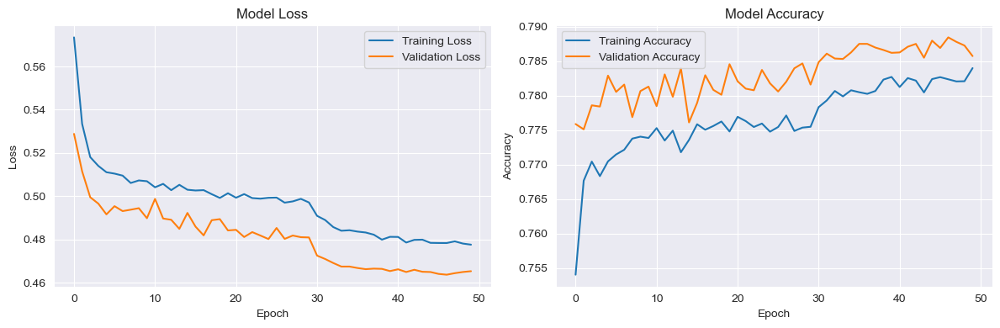

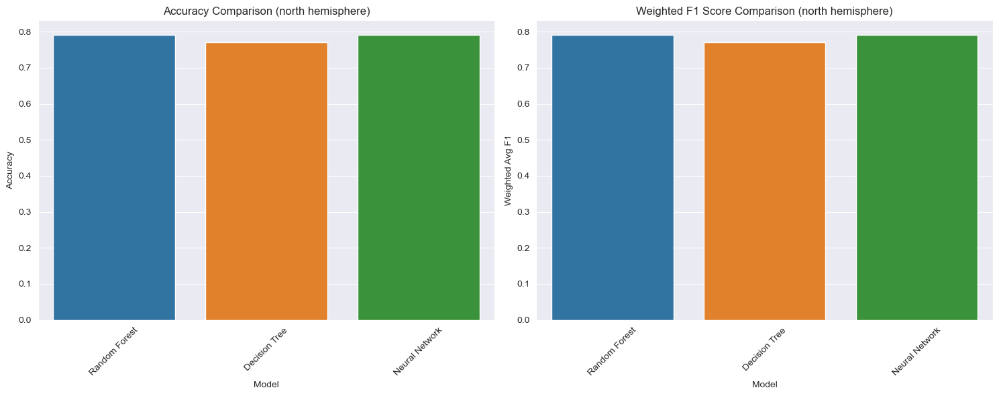


North Hemisphere Results:
            Model  Accuracy  Macro Avg F1  Weighted Avg F1
0   Random Forest  0.790884      0.790877         0.790875
1   Decision Tree  0.770737      0.770710         0.770706
2  Neural Network  0.791781      0.791778         0.791777

Training South Hemisphere Models...


/Users/beastxgamer/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1500 with 0 Axes>

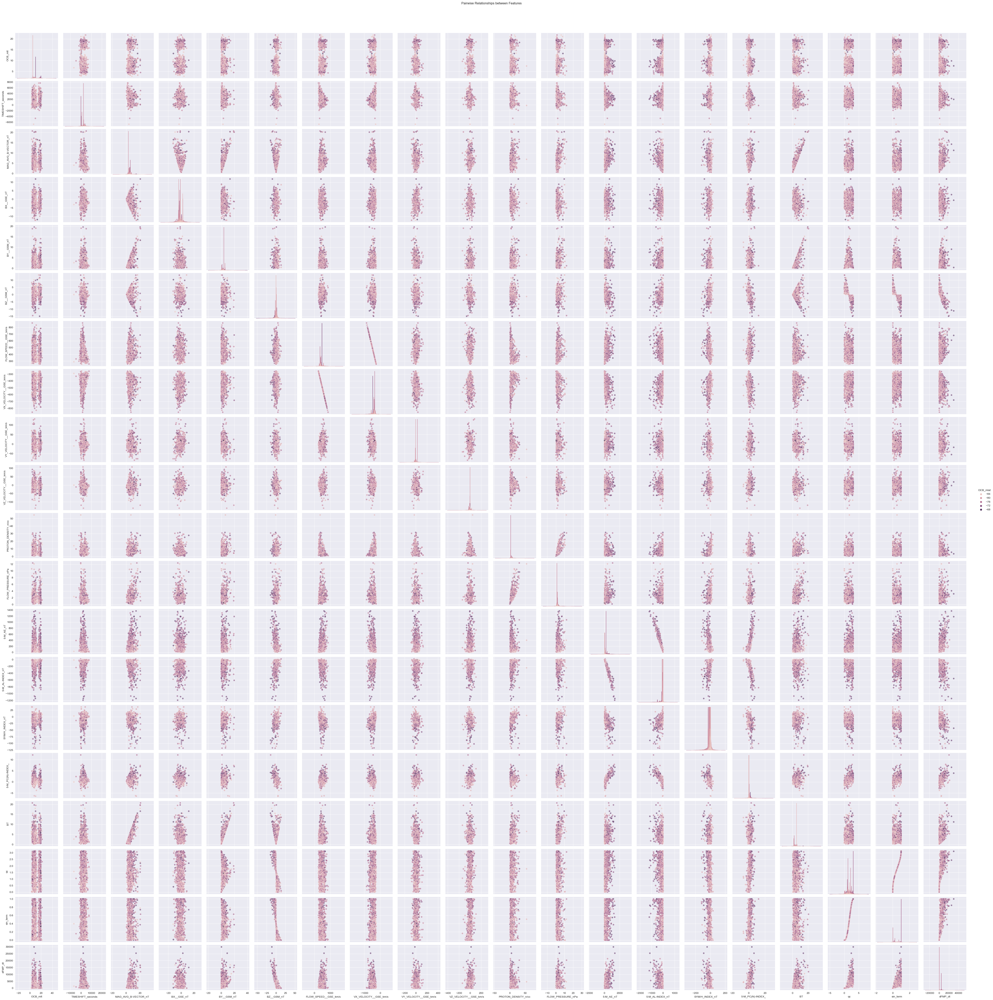


Training Random Forest...


/Users/beastxgamer/anaconda3/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


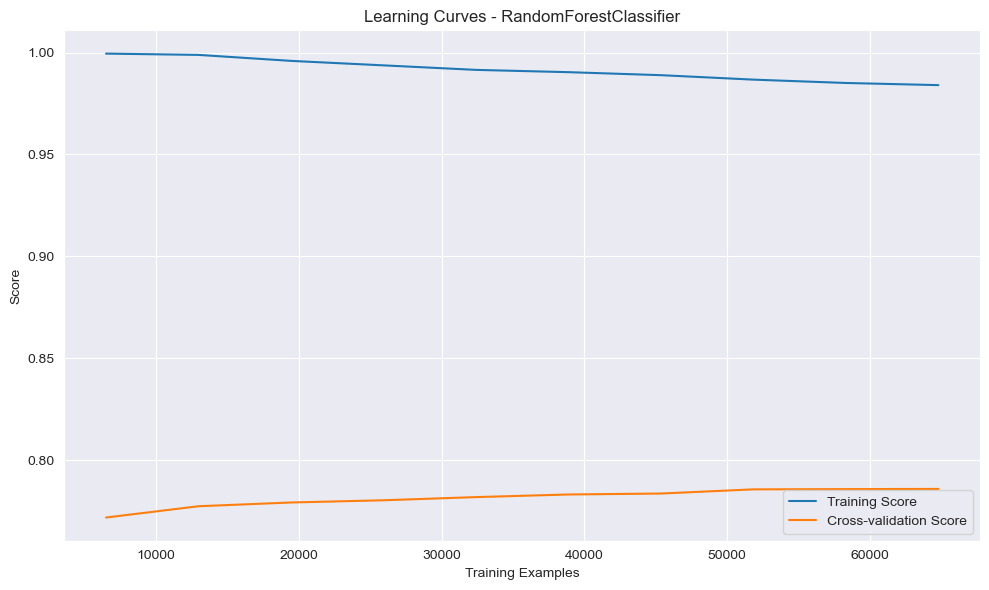

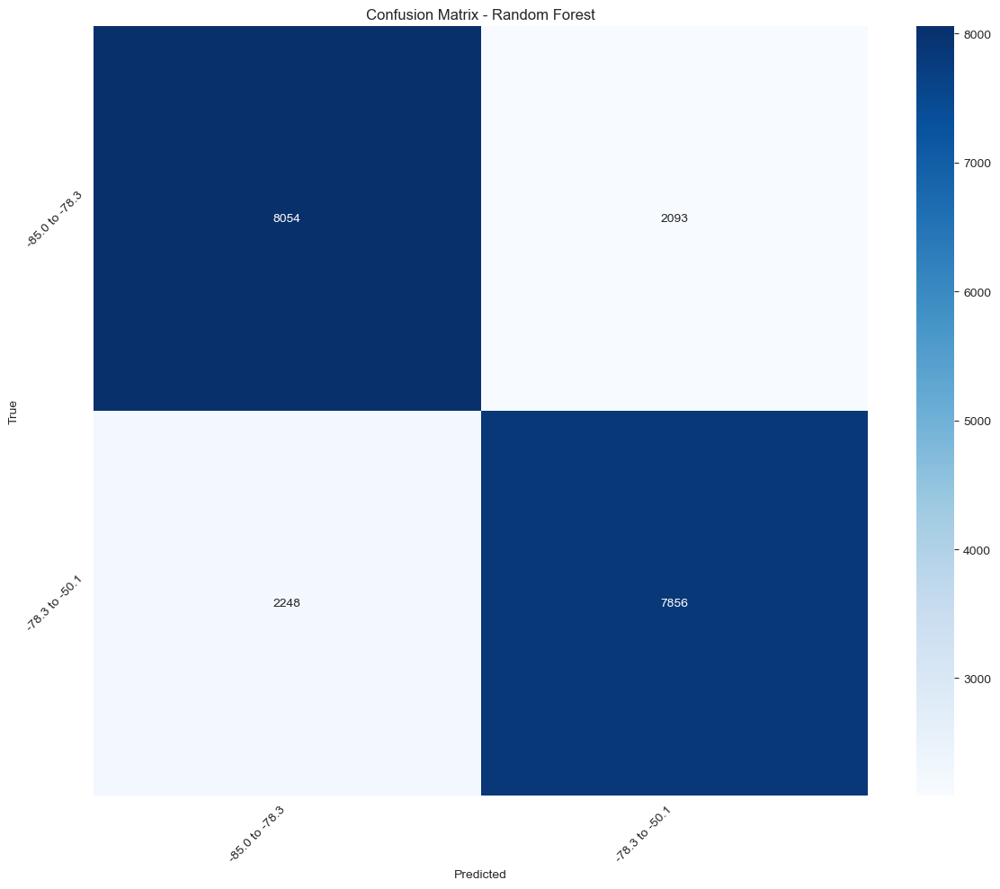

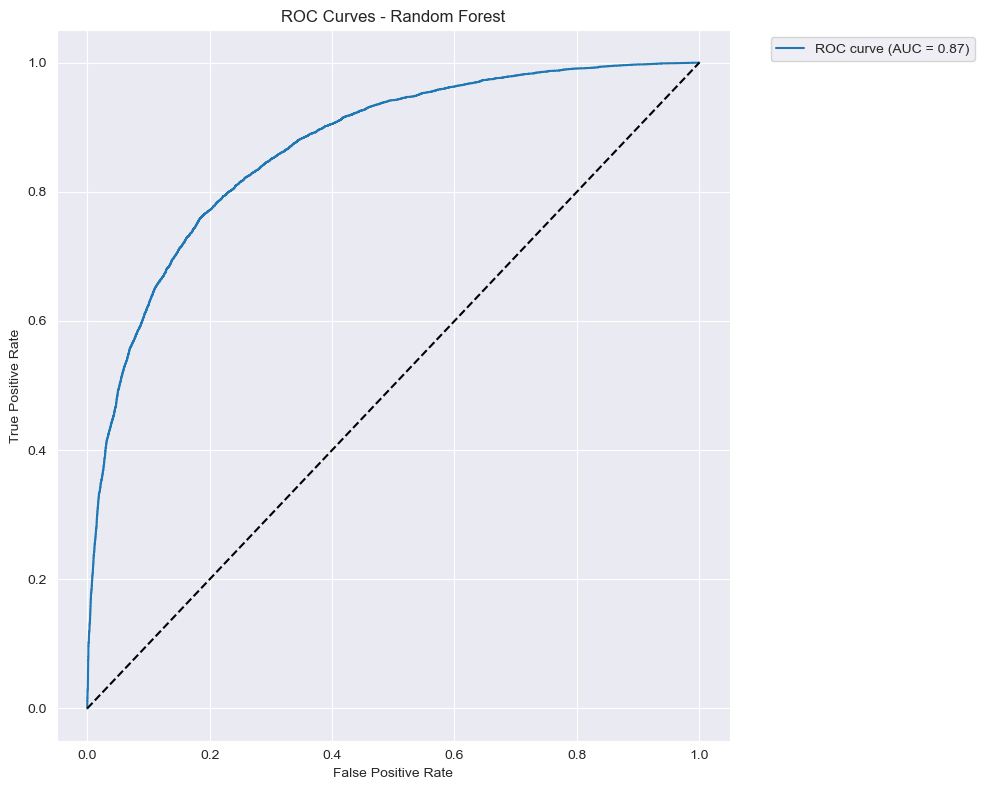

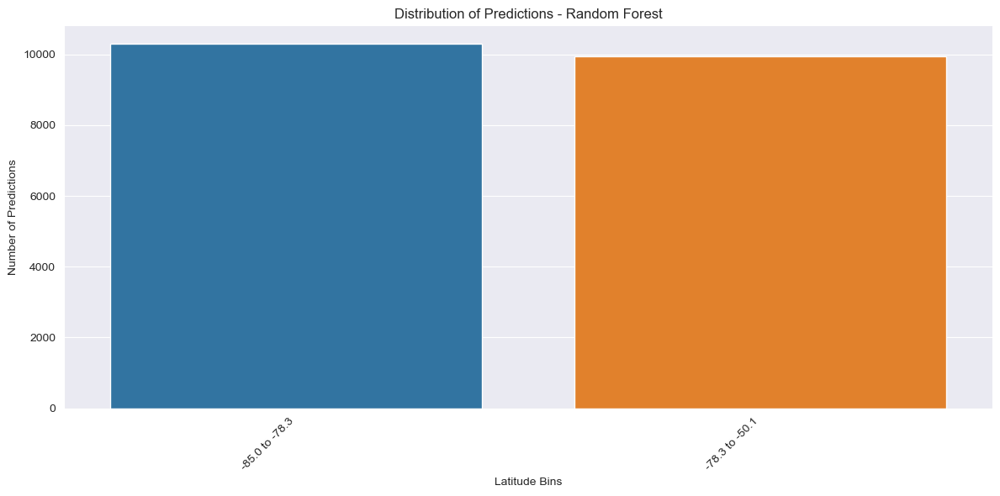

Best parameters for Random Forest: {'max_depth': 20, 'min_samples_split': 2, 'n_estimators': 200}

Classification Report:
                precision    recall  f1-score   support

-85.0 to -78.3       0.78      0.79      0.79     10147
-78.3 to -50.1       0.79      0.78      0.78     10104

      accuracy                           0.79     20251
     macro avg       0.79      0.79      0.79     20251
  weighted avg       0.79      0.79      0.79     20251


Training Decision Tree...


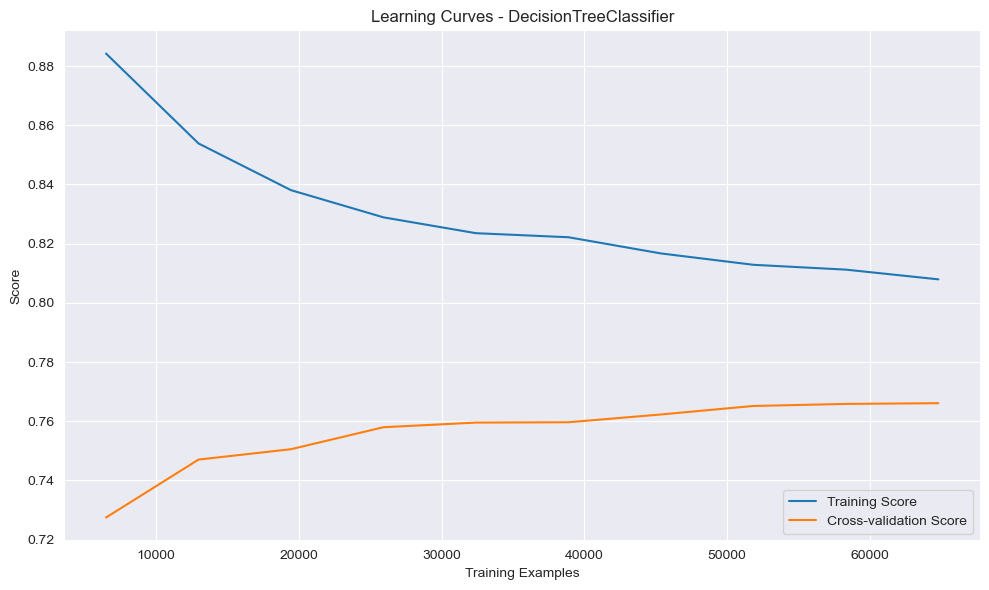

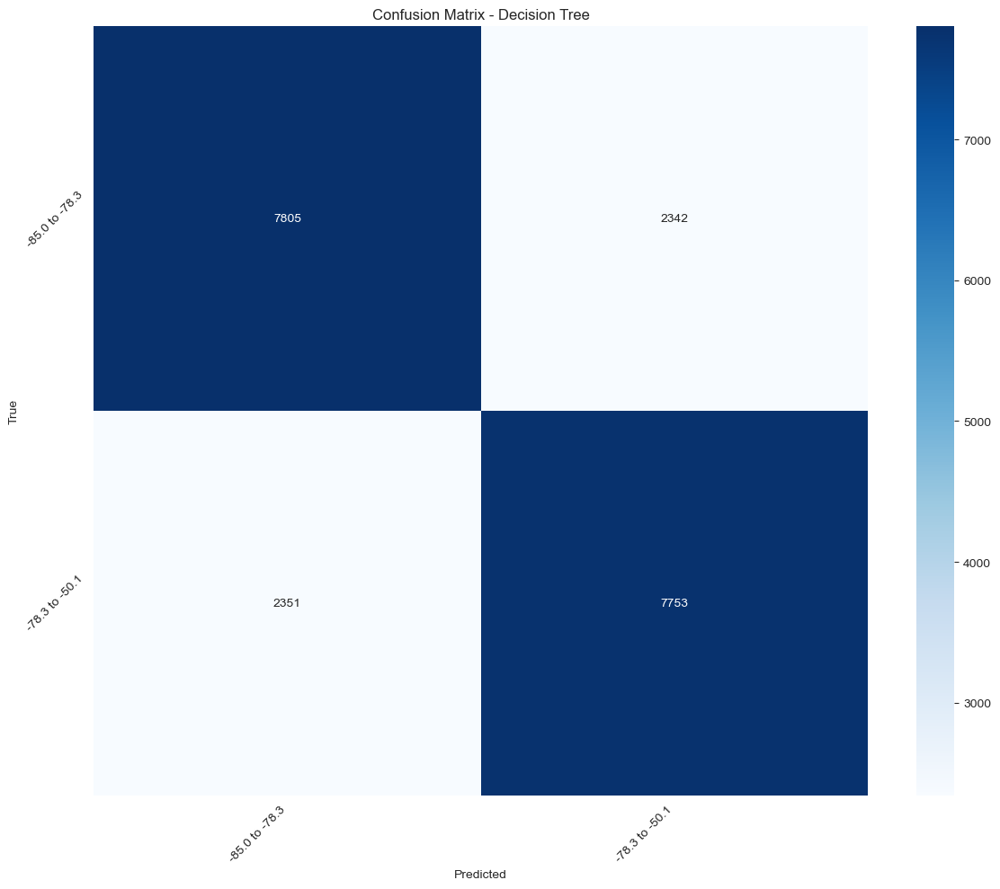

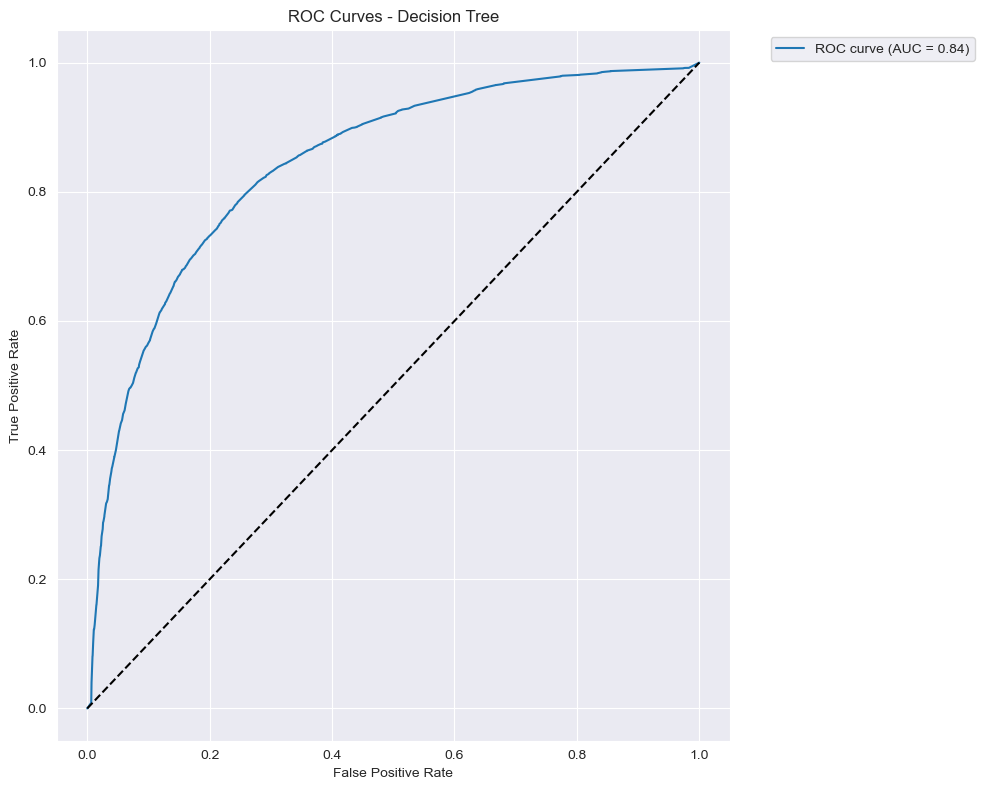

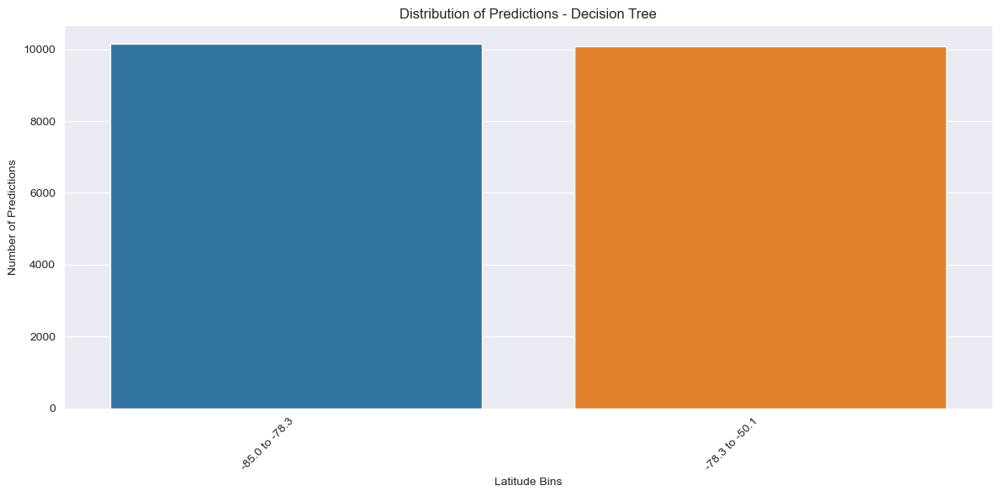

Best parameters for Decision Tree: {'max_depth': 10, 'min_samples_split': 2}

Classification Report:
                precision    recall  f1-score   support

-85.0 to -78.3       0.77      0.77      0.77     10147
-78.3 to -50.1       0.77      0.77      0.77     10104

      accuracy                           0.77     20251
     macro avg       0.77      0.77      0.77     20251
  weighted avg       0.77      0.77      0.77     20251



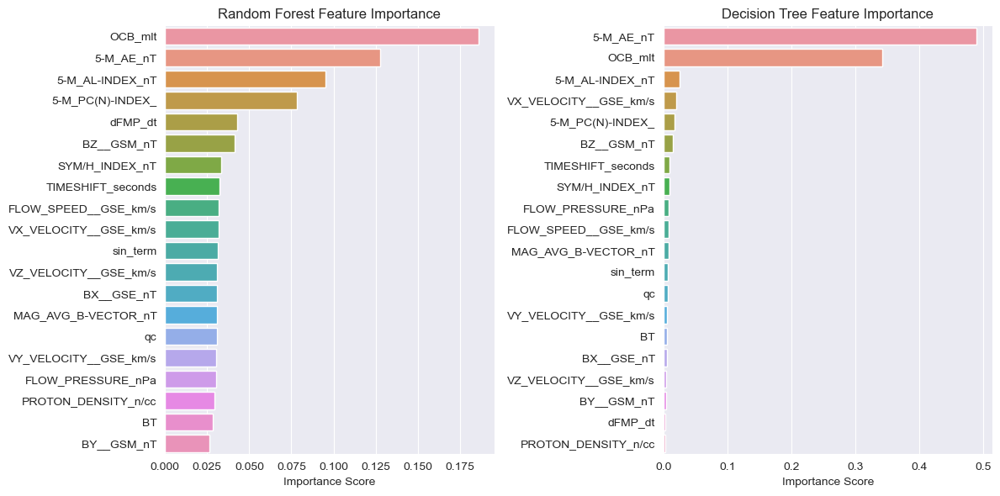


Training Neural Network...
Epoch 1/50
2026/2026 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - accuracy: 0.7147 - loss: 0.6260 - val_accuracy: 0.7621 - val_loss: 0.5415 - learning_rate: 0.0010
Epoch 2/50
2026/2026 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7524 - loss: 0.5490 - val_accuracy: 0.7636 - val_loss: 0.5227 - learning_rate: 0.0010
Epoch 3/50
2026/2026 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7570 - loss: 0.5318 - val_accuracy: 0.7712 - val_loss: 0.5035 - learning_rate: 0.0010
Epoch 4/50
2026/2026 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7597 - loss: 0.5178 - val_accuracy: 0.7709 - val_loss: 0.5033 - learning_rate: 0.0010
Epoch 5/50
2026/2026 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7568 - loss: 0.5221 - val_accuracy: 0.7691 - val_loss: 0.5046 - learning_rate: 0.0010
Epoch 6/50
2026/2026 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7583 - loss: 0.5200 - val_accuracy: 0.7703 - val_loss: 0.5010 - learning_rate: 0.0010
Epoch 7/50
2026/2026 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms

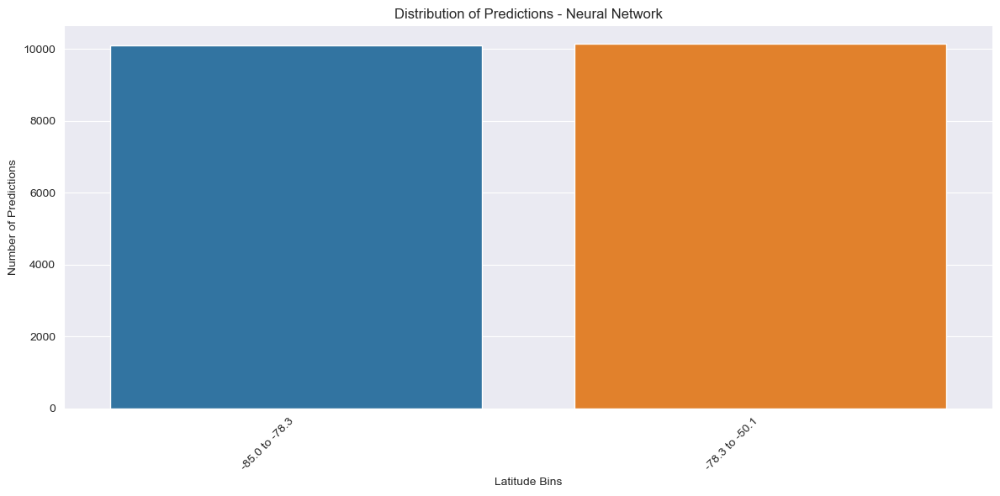

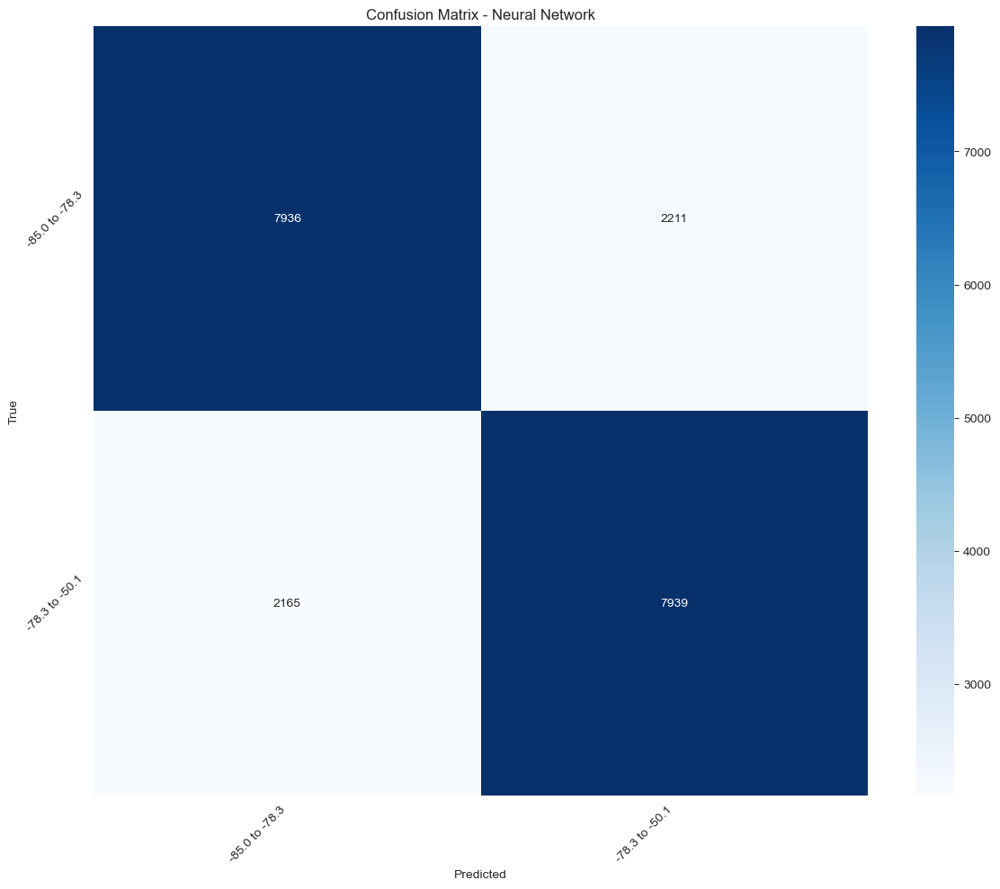

633/633 ━━━━━━━━━━━━━━━━━━━━ 0s 465us/step


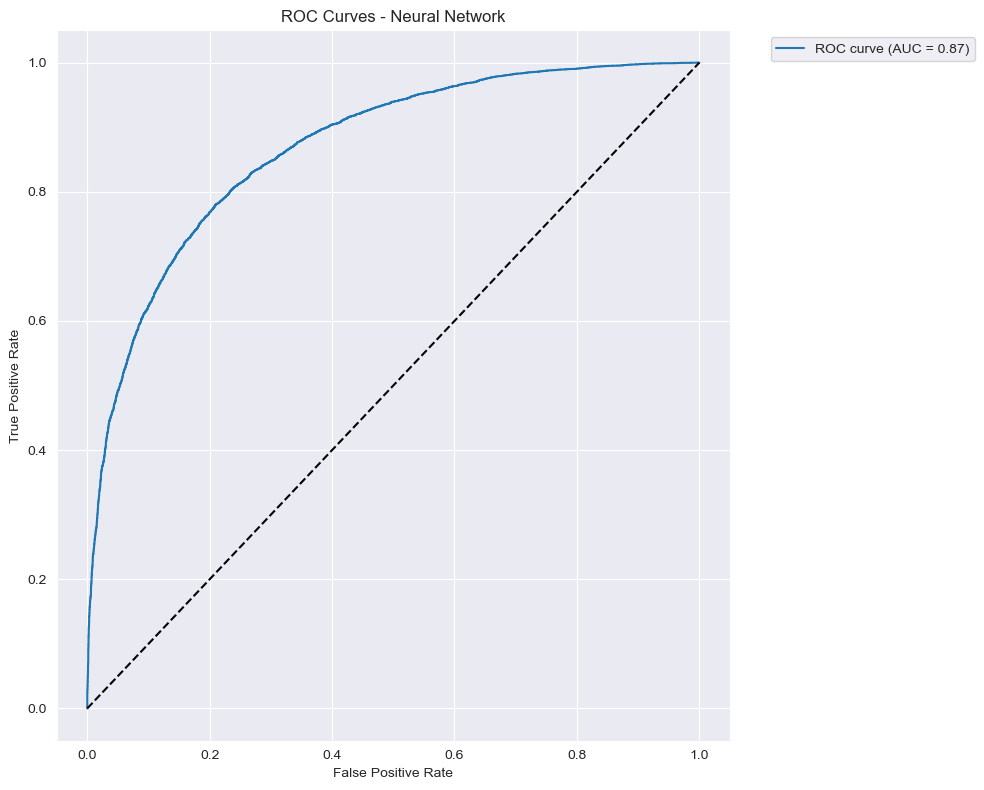


Neural Network Classification Report:
                precision    recall  f1-score   support

-85.0 to -78.3       0.79      0.78      0.78     10147
-78.3 to -50.1       0.78      0.79      0.78     10104

      accuracy                           0.78     20251
     macro avg       0.78      0.78      0.78     20251
  weighted avg       0.78      0.78      0.78     20251



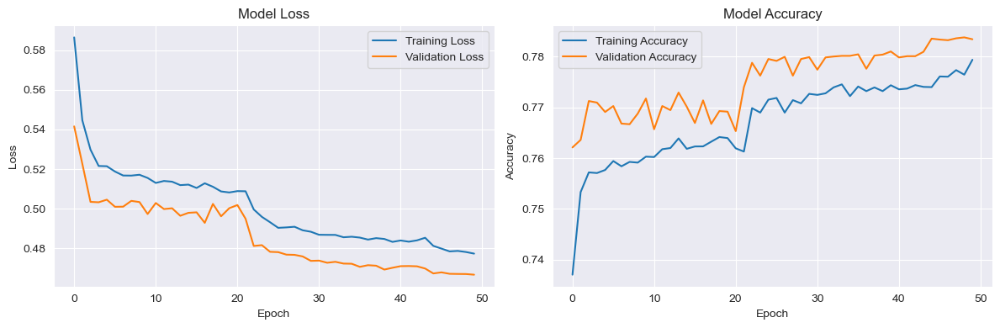

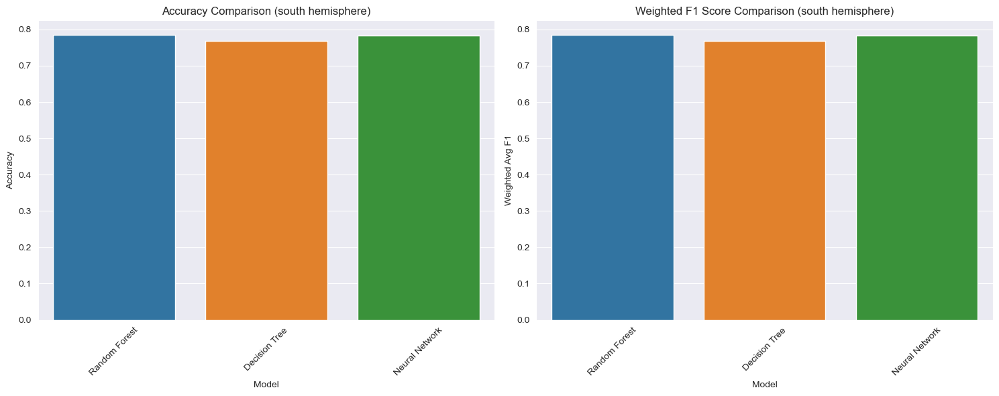


South Hemisphere Results:
            Model  Accuracy  Macro Avg F1  Weighted Avg F1
0   Random Forest  0.785640      0.785620         0.785624
1   Decision Tree  0.768258      0.768257         0.768258
2  Neural Network  0.783912      0.783912         0.783912


In [17]:
### Dayside Testing ####
# Define your features and target
features_dayside = ['OCB_mlt', 'TIMESHIFT_seconds',
       'MAG_AVG_B-VECTOR_nT', 'BX__GSE_nT', 'BY__GSM_nT', 'BZ__GSM_nT',
       'FLOW_SPEED__GSE_km/s', 'VX_VELOCITY__GSE_km/s',
       'VY_VELOCITY__GSE_km/s', 'VZ_VELOCITY__GSE_km/s', 'PROTON_DENSITY_n/cc',
       'FLOW_PRESSURE_nPa', '5-M_AE_nT', '5-M_AL-INDEX_nT', 'SYM/H_INDEX_nT',
       '5-M_PC(N)-INDEX_', 'BT', 'qc', 'sin_term', 'dFMP_dt'
]
target_dayside = 'OCB_mlat'

print("Training North Hemisphere Models...")
north_results, north_models, north_scaler, north_edges, north_labels, north_history = train_classification_models(daysideN_df, features_dayside, target_dayside, 'north', n_bins=2)
print("\nNorth Hemisphere Results:")
print(north_results)

print("\nTraining South Hemisphere Models...")
south_results, south_models, south_scaler, south_edges, south_labels, south_history = train_classification_models(daysideS_df, features_dayside, target_dayside, 'south', n_bins=2)
print("\nSouth Hemisphere Results:")
print(south_results)

In [19]:
print(nightside_df.columns)

Index(['b6_date', 'b6_mag_lat', 'b6_mlt', 'b2i_mag_lat', 'MAG_AVG_B-VECTOR_nT',
       'BZ__GSM_nT', 'FLOW_PRESSURE_nPa', 'FLOW_SPEED__GSE_km/s', '5-M_AE_nT',
       'SYM/H_INDEX_nT', '5-M_PC(N)-INDEX_', 'PROTON_DENSITY_n/cc', 'dFMP_dt'],
      dtype='object')
